# Data Collection and Preprocessing

main folder: `/storage/remote/atcremers51/truck_platooning/`
<br>
All scripts and example data for this notebook are stored in the folder: *data_collection*. **To run this notebook , please place the folder and this notebook to: `/storage/group/intellisys/CARLA/Carla_0.9.11/PythonAPI/examples/`.**

In this notebook, 4 data collection methods used in the truck platooning project for different models are introduced in detail, including:
1. Online Carla collection with random positions - version 1
2. Online Carla collection with random positions - version 2
3. Data collection for CNN-MLP model with depth camera
4. Data collection for CNN-MLP model with stereo camera

# 1. Online Carla collection with random positions - version 1

### 1.1 The script

The very first method is the online Carla collection with random positions, which was used for collecting raw states for MLP model with raw states with the online-mode method. The images are not collected with this method.
<br>
To run the data collection with random positions, first should run the Carla simulator with:
<br>
`DISPLAY= ./CarlaUE4.sh -opengl`
<br>
The .py script is stored under: `data_collection/online_carla_ver1/carla_online_ver1.py`

In [2]:
! python data_collection/online_carla_ver1/carla_online_ver1.py 

created target vehicle vehicle.audi.a2
created ego vehicle vehicle.audi.a2
created sensor.camera.rgb
Create vehicle_follow and vehicle_lead in the figure.
frame 0
TARGET Vehicle
Location: (x,y,z): (223.1039276123047,-395.6427001953125,0.22806409001350403)
Throttle: 0.0, Steering Angle: 0.0, Brake: 0.0
EGO Vehicle
Location: (x,y,z): (231.1039276123047,-395.6427001953125,0.22806409001350403)
Throttle: 0.0, Steering Angle: 0.0, Brake: 0.0
frame 1
TARGET Vehicle
Location: (x,y,z): (223.1039276123047,-395.6427001953125,0.07629331201314926)
Throttle: 0.699999988079071, Steering Angle: 0.0, Brake: 0.0
EGO Vehicle
Location: (x,y,z): (231.1039276123047,-395.6427001953125,0.07629331201314926)
Throttle: 1.0, Steering Angle: -1.6980564396362752e-05, Brake: 0.0
frame 2
TARGET Vehicle
Location: (x,y,z): (223.10372924804688,-395.64263916015625,-0.03778749331831932)
Throttle: 0.699999988079071, Steering Angle: 0.0, Brake: 0.0
EGO Vehicle
Location: (x,y,z): (231.10374450683594,-395.6427001953125,-0.037

QObject::moveToThread: Current thread (0x563eacaada80) is not the object's thread (0x563eaccfc760).
Cannot move to target thread (0x563eacaada80)

QObject::moveToThread: Current thread (0x563eacaada80) is not the object's thread (0x563eaccfc760).
Cannot move to target thread (0x563eacaada80)

frame 13
TARGET Vehicle
Location: (x,y,z): (223.10372924804688,-395.6426086425781,-0.007698421366512775)
Throttle: 0.699999988079071, Steering Angle: 2.3848144792282255e-07, Brake: 0.0
EGO Vehicle
Location: (x,y,z): (231.10374450683594,-395.64263916015625,-0.007650165352970362)
Throttle: 1.0, Steering Angle: 0.001879172632470727, Brake: 0.0
frame 14
TARGET Vehicle
Location: (x,y,z): (223.10372924804688,-395.6426086425781,-0.007719287648797035)
Throttle: 0.699999988079071, Steering Angle: 2.3848144792282255e-07, Brake: 0.0
EGO Vehicle
Location: (x,y,z): (231.10374450683594,-395.64263916015625,-0.00769960368052125)
Throttle: 1.0, Steering Angle: 0.000971836328972131, Brake: 0.0
frame 15
TARGET Vehic

### 1.2 Parameters

This example script is shown with spawn point 5 in Town04, this can be changed at line 157 and 170. Please collect the control list first before changing, which is introduced in 1.2. 
<br>
For any frame number divisible by 10, N_sample number of random positions for the ego vehicle are created in the neighborhood. After running from one random position for N_frame number of frames, the ego vehicle will be moved to another random position. The parameters N_sample and N_frame are editable at line 40 and 41.

### 1.3 Controllers for target and ego vehicles

It can be seen in the script that the ego vehicle is controlled by the MPC, the plant model and cost function are designed in another script called 'test_mpc.py', which is imported into the script at line 25. The scripts introduced in an [online course](https://github.com/WuStangDan/mpc-course-assignments) The target vehicle drives with autopilot.

### 1.4 Output

The raw states of each frame, which are used as inputs of the MLP model with raw states, are written down in the 'model_input.py', which is stored under `data_collection/online_carla_ver1/output/model_input.py`. The corresponding control values generated from the MPC, which are used as ground truth for training the MLP model, are written down in the 'model_input.py', which is stored under the same folder as 'model_input.py'.

### 1.5 Example Dataset

The dataset we collected is stored under `dataset/MLP_raw_dataset` and we used it for training the MLP model with raw states

# 2. Online Carla collection with random positions - version 2

### 2.1 The script

In the version 1, only states are written down, but not images. What's more, the raw states are stored in .py file, which needs to be preprocessed before training. Thus, we updated the online collection method, data collected with this method is used for training MLP with relative states, CNN end-to-end and CNN-MLP with only one RGB camera.
<br>
To run the data collection with random positions, first should run the Carla simulator with:
<br>
`DISPLAY= ./CarlaUE4.sh -opengl`

The scipts for collecting on-trajectory data and off-trajectory data are different, with little difference in between, first is the script for collecting **on-trajectory data**:
<br>
The .py script is stored under: `data_collection/online_carla_ver2/carla_online_ver2_on.py`

In [2]:
! python data_collection/online_carla_ver2/carla_online_ver2_on.py 

created target vehicle vehicle.audi.a2
created ego vehicle vehicle.audi.a2
created sensor.camera.rgb
created sensor.camera.rgb
Create vehicle_follow and vehicle_lead in the figure.
frame 0
TARGET Vehicle
Location: (x,y,z): (223.1039276123047,-395.6427001953125,0.22806409001350403)
Throttle: 0.0, Steering Angle: 0.0, Brake: 0.0
EGO Vehicle
Location: (x,y,z): (231.1039276123047,-395.6427001953125,0.22806409001350403)
Throttle: 0.0, Steering Angle: 0.0, Brake: 0.0
frame 1
TARGET Vehicle
Location: (x,y,z): (223.1039276123047,-395.6427001953125,0.07629331201314926)
Throttle: 0.699999988079071, Steering Angle: 0.0, Brake: 0.0
EGO Vehicle
Location: (x,y,z): (231.1039276123047,-395.6427001953125,0.07629331201314926)
Throttle: 1.0, Steering Angle: -1.6980564396362752e-05, Brake: 0.0
frame 2
TARGET Vehicle
Location: (x,y,z): (223.10372924804688,-395.64263916015625,-0.03778749331831932)
Throttle: 0.699999988079071, Steering Angle: 0.0, Brake: 0.0
EGO Vehicle
Location: (x,y,z): (231.10374450683594

TARGET Vehicle
Location: (x,y,z): (223.10372924804688,-395.6426086425781,-0.007698421366512775)
Throttle: 0.699999988079071, Steering Angle: 2.4706503154448e-07, Brake: 0.0
EGO Vehicle
Location: (x,y,z): (231.10374450683594,-395.64263916015625,-0.007650165352970362)
Throttle: 1.0, Steering Angle: 0.00244325608946383, Brake: 0.0
frame 14
TARGET Vehicle
Location: (x,y,z): (223.10372924804688,-395.6426086425781,-0.007719249464571476)
Throttle: 0.699999988079071, Steering Angle: 2.4706503154448e-07, Brake: 0.0
EGO Vehicle
Location: (x,y,z): (231.10374450683594,-395.64263916015625,-0.0076995654962956905)
Throttle: 1.0, Steering Angle: 0.00037878923467360437, Brake: 0.0
frame 15
TARGET Vehicle
Location: (x,y,z): (223.10372924804688,-395.6426086425781,-0.007721881847828627)
Throttle: 0.699999988079071, Steering Angle: 2.4706503154448e-07, Brake: 0.0
EGO Vehicle
Location: (x,y,z): (231.10374450683594,-395.64263916015625,-0.007705554831773043)
Throttle: 1.0, Steering Angle: 0.000389956083381548

Then, is the script for collecting **off-trajectory data:**
<br>
The .py script is stored under: `data_collection/online_carla_ver2/carla_online_ver2_off.py`

In [1]:
! python data_collection/online_carla_ver2/carla_online_ver2_off.py 

created target vehicle vehicle.audi.a2
created ego vehicle vehicle.audi.a2
created sensor.camera.rgb
created sensor.camera.rgb
Create vehicle_follow and vehicle_lead in the figure.
frame 0
TARGET Vehicle
Location: (x,y,z): (223.1039276123047,-395.6427001953125,0.22806409001350403)
Throttle: 0.0, Steering Angle: 0.0, Brake: 0.0
EGO Vehicle
Location: (x,y,z): (231.1039276123047,-395.6427001953125,0.22806409001350403)
Throttle: 0.0, Steering Angle: 0.0, Brake: 0.0
frame 1
TARGET Vehicle
Location: (x,y,z): (223.1039276123047,-395.6427001953125,0.07629331201314926)
Throttle: 0.699999988079071, Steering Angle: 0.0, Brake: 0.0
EGO Vehicle
Location: (x,y,z): (231.1039276123047,-395.6427001953125,0.07629331201314926)
Throttle: 1.0, Steering Angle: -1.6980564396362752e-05, Brake: 0.0
frame 2
TARGET Vehicle
Location: (x,y,z): (223.10372924804688,-395.64263916015625,-0.03778749331831932)
Throttle: 0.699999988079071, Steering Angle: 0.0, Brake: 0.0
EGO Vehicle
Location: (x,y,z): (231.10374450683594

QObject::moveToThread: Current thread (0x55b88e94e460) is not the object's thread (0x55b88f19fd20).
Cannot move to target thread (0x55b88e94e460)

QObject::moveToThread: Current thread (0x55b88e94e460) is not the object's thread (0x55b88f19fd20).
Cannot move to target thread (0x55b88e94e460)

frame 13
TARGET Vehicle
Location: (x,y,z): (223.10372924804688,-395.6426086425781,-0.007698421366512775)
Throttle: 0.699999988079071, Steering Angle: 2.3800457427114452e-07, Brake: 0.0
EGO Vehicle
Location: (x,y,z): (231.10374450683594,-395.64263916015625,-0.007650165352970362)
Throttle: 1.0, Steering Angle: 0.0017290714895352721, Brake: 0.0
frame 14
TARGET Vehicle
Location: (x,y,z): (223.10372924804688,-395.6426086425781,-0.007719287648797035)
Throttle: 0.699999988079071, Steering Angle: 2.3800457427114452e-07, Brake: 0.0
EGO Vehicle
Location: (x,y,z): (231.10374450683594,-395.64263916015625,-0.007699641864746809)
Throttle: 1.0, Steering Angle: 0.0002738902985583991, Brake: 0.0
frame 15
TARGET Ve

frame 36
TARGET Vehicle
Location: (x,y,z): (218.64837646484375,-395.67529296875,-0.007048740051686764)
Throttle: 0.4174076318740845, Steering Angle: 1.9526976302586263e-06, Brake: 0.0
EGO Vehicle
Location: (x,y,z): (226.20851135253906,-395.6381530761719,-0.003929653204977512)
Throttle: 0.48421329259872437, Steering Angle: -0.014139545150101185, Brake: 0.0
frame 37
TARGET Vehicle
Location: (x,y,z): (218.18763732910156,-395.6788330078125,-0.006995716132223606)
Throttle: 0.456068754196167, Steering Angle: -8.76686272022198e-07, Brake: 0.0
EGO Vehicle
Location: (x,y,z): (225.80691528320312,-395.6420593261719,-0.004385242238640785)
Throttle: 0.9999985098838806, Steering Angle: 0.03622325882315636, Brake: 0.0
frame 38
TARGET Vehicle
Location: (x,y,z): (217.73052978515625,-395.6823425292969,-0.007199649699032307)
Throttle: 0.47884511947631836, Steering Angle: 1.7974547006360808e-07, Brake: 0.0
EGO Vehicle
Location: (x,y,z): (225.3919677734375,-395.6482849121094,-0.006572131998836994)
Throttle

### 2.2 Parameters

This example script is shown with spawn point 5 in Town04, which can be changed to any spawn point in any town. Please collect the control list first before changing, which is introduced in 1.2. 
<br>
Parameters N_sample and N_frame can be found in the script 'carla_online_ver2_off.py'. For any frame number divisible by 10, N_sample number of random positions for the ego vehicle are created in the neighborhood. After running from one random position for N_frame number of frames, the ego vehicle will be moved to another random position. The parameters N_sample and N_frame are editable at line 40 and 41 in 'carla_online_ver2_off.py'

### 2.3 Controllers for target and ego vehicles

The Controllers in both scripts are exactly the same as in 1.3.

### 2.4 Output

In each frame, both raw states and control values are written down in a txt file toghther, which is imported in the training script as inputs and ground truth labels. The images captured by the RGB camera and the txt file are stored under `data_collection/online_carla_ver2/output`.

### 2.5 Example Dataset

The dataset we collected is stored under `dataset/carla_online_dataset` and we used it for training the MLP model with relative states, CNN end-to-end and CNN-MLP with RGB camera.

# 3. Data collection for CNN-MLP model with depth camera 

This data collection method combines online-mode method and offline-mode method, with online-mode used for collecting on-trajectory data and offline image rendering used for off-trajectory data.

###  3. 1 Online on-trajectory data collection

This method is used to collect only on-trajectory data with online-mode method, the `dataset/ontrajectory_dataset` is collected in this way as well, which is used for training the model with only on-trajectory data.
<br>
To collect the on-trajectory with online-mode method, first should run the Carla simulator with:
<br>
`DISPLAY= ./CarlaUE4.sh -opengl`

In [4]:
! python data_collection/depth_data/carla_online_RGB_depth.py

created target vehicle vehicle.audi.a2
created ego vehicle vehicle.audi.a2
created sensor.camera.depth
created sensor.camera.rgb
created sensor.camera.rgb
Create vehicle_follow and vehicle_lead in the figure.
frame 0
TARGET Vehicle
Location: (x,y,z): (223.1039276123047,-395.6427001953125,0.22806409001350403)
Throttle: 0.0, Steering Angle: 0.0, Brake: 0.0
EGO Vehicle
Location: (x,y,z): (231.1039276123047,-395.6427001953125,0.22806409001350403)
Throttle: 0.0, Steering Angle: 0.0, Brake: 0.0
frame 1
TARGET Vehicle
Location: (x,y,z): (223.1039276123047,-395.6427001953125,0.07629331201314926)
Throttle: 0.699999988079071, Steering Angle: 0.0, Brake: 0.0
EGO Vehicle
Location: (x,y,z): (231.1039276123047,-395.6427001953125,0.07629331201314926)
Throttle: 1.0, Steering Angle: -1.6980564396362752e-05, Brake: 0.0
frame 2
TARGET Vehicle
Location: (x,y,z): (223.10372924804688,-395.64263916015625,-0.03778749331831932)
Throttle: 0.699999988079071, Steering Angle: 0.0, Brake: 0.0
EGO Vehicle
Location: 

frame 13
TARGET Vehicle
Location: (x,y,z): (223.10372924804688,-395.6426086425781,-0.007698421366512775)
Throttle: 0.699999988079071, Steering Angle: 2.3532220438937657e-07, Brake: 0.0
EGO Vehicle
Location: (x,y,z): (231.10374450683594,-395.64263916015625,-0.007650165352970362)
Throttle: 1.0, Steering Angle: 0.0019035000586882234, Brake: 0.0
frame 14
TARGET Vehicle
Location: (x,y,z): (223.10372924804688,-395.6426086425781,-0.007719287648797035)
Throttle: 0.699999988079071, Steering Angle: 2.3532220438937657e-07, Brake: 0.0
EGO Vehicle
Location: (x,y,z): (231.10374450683594,-395.64263916015625,-0.007699641864746809)
Throttle: 1.0, Steering Angle: 0.0008904524729587138, Brake: 0.0
frame 15
TARGET Vehicle
Location: (x,y,z): (223.10372924804688,-395.6426086425781,-0.007721881847828627)
Throttle: 0.699999988079071, Steering Angle: 2.3532220438937657e-07, Brake: 0.0
EGO Vehicle
Location: (x,y,z): (231.10374450683594,-395.64263916015625,-0.007705554831773043)
Throttle: 1.0, Steering Angle: 0.

The outputs of this script include RGB images from the RGB camera, depth images from the depth camera and raw states, which are all stored in the folder data_collection/depth_data/output automatically.
<br>
This example script is shown with spawn point 5 in town4, this can be changed at line 155 and 169.
<br>
To collect for different trajectories, the parameter FLAG at line 35 should be modified each time.

### 3.2 Offline image rendering for off-trajectory data

Instead of collect off-trajectory data online with the Carla simulator, off-trajectory data are generated with image rendering method offline. Pre-collected images and data are used as example, these are stored in data_collection/depth_data/Example_test. Helper function is written in the script `data_collection/depth_data/RGB_depth_offline.py`.
<br>
*The notebook is written based on tutorial of assignment 4.*

In [1]:
import sys
from data_collection.depth_data.RGB_depth_offline import depth_rendering
FOLDER = sys.path[0]+'/data_collection/depth_data/Example_test/'

num 0
FLAG 0
0
random transfer 0 -0.3761414073646133 -0.047511602351660256
original delta 7.999975092288789 0.019963034813144986 -2.3461320663938416e-19
delta data 7.972134932232459 0.7756061040456922 0.047511602351660256
Point Coud 1, projected back to image 2


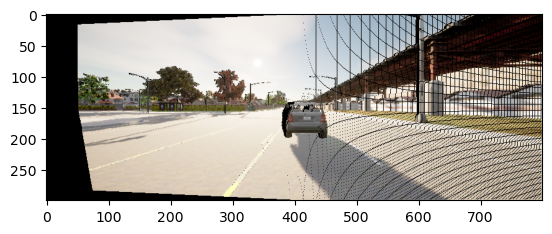

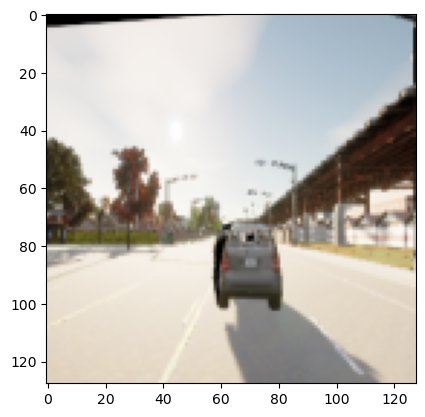

saved to disk
random transfer 0 -0.5180443822300769 0.04075664989847305
original delta 7.999975092288789 0.019963034813144986 -2.3461320663938416e-19
delta data 8.015252924466202 0.211598711883008 -0.04075664989847306
Point Coud 1, projected back to image 2


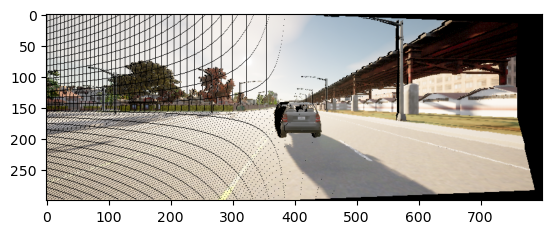

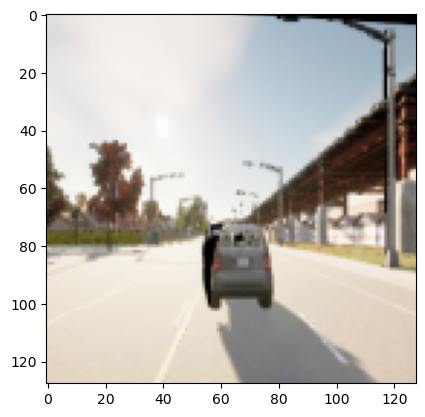

saved to disk
random transfer 0 -0.3967710772894586 -0.14008837215868625
original delta 7.999975092288789 0.019963034813144986 -2.3461320663938416e-19
delta data 7.8634157781263525 1.5296931384249906 0.14008837215868625
Point Coud 1, projected back to image 2


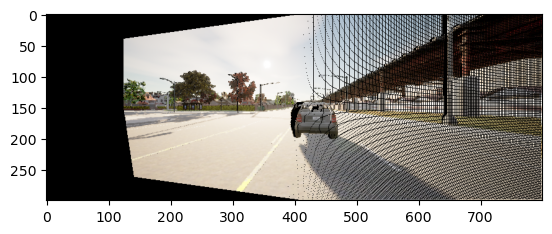

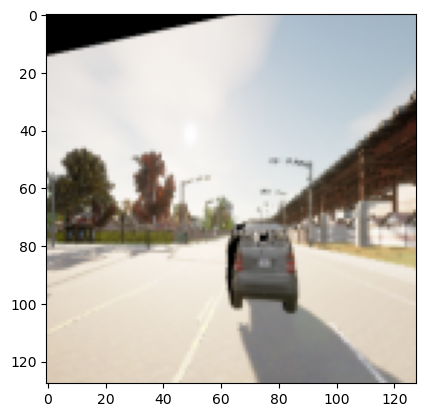

saved to disk
random transfer 0 -0.9859864684426176 0.14892360296768353
original delta 7.999975092288789 0.019963034813144986 -2.3461320663938416e-19
delta data 8.060682732718384 -0.19217118097474395 -0.14892360296768353
Point Coud 1, projected back to image 2


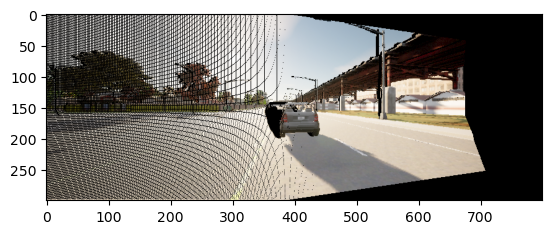

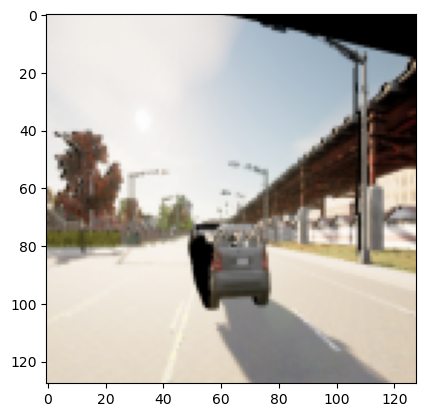

saved to disk
original delta 7.999975092288789 0.019963034813144986 -2.3461320663938416e-19
delta data 7.999975092288789 0.019963034813144986 -2.3461320663938416e-19
Point Coud 1, projected back to image 2


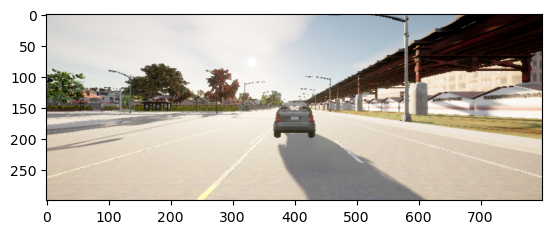

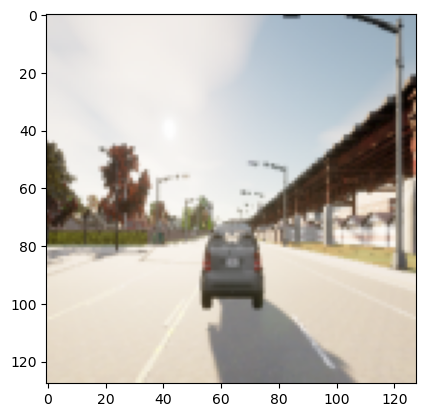

saved to disk
random transfer 1.196696757477226 0 0
original delta 7.999975092288789 0.019963034813144986 -2.3461320663938416e-19
delta data 6.803278334811563 0.019963034813144986 -2.3461320663938416e-19
Point Coud 1, projected back to image 2


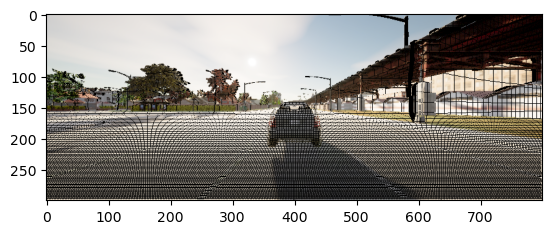

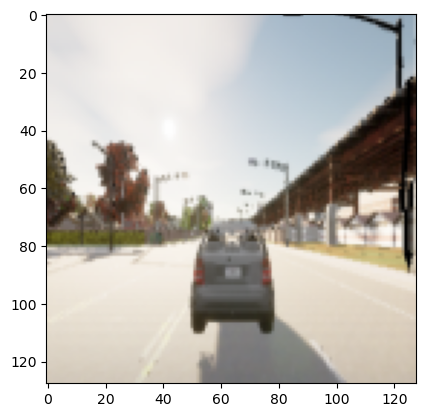

saved to disk
random transfer -1.0221908488205684 0 0
original delta 7.999975092288789 0.019963034813144986 -2.3461320663938416e-19
delta data 9.022165941109357 0.019963034813144986 -2.3461320663938416e-19
Point Coud 1, projected back to image 2


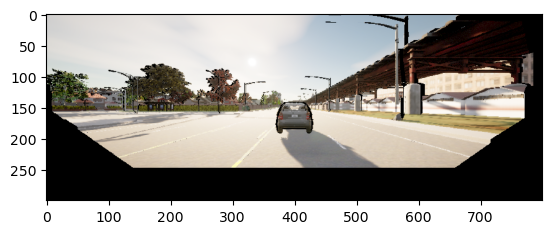

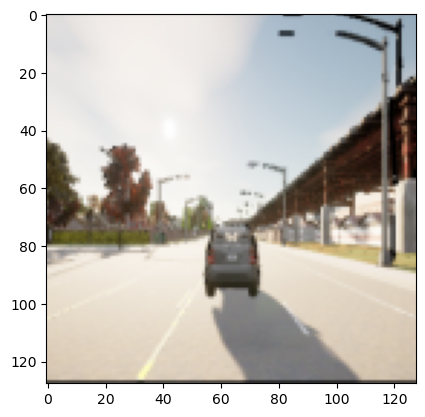

saved to disk
1
random transfer 0 0.623249631282452 0.015090529140633718
original delta 7.999975092288789 0.019963034813144986 -2.3461320663938416e-19
delta data 7.989960647693703 -0.7239371816853871 -0.015090529140633718
Point Coud 1, projected back to image 2


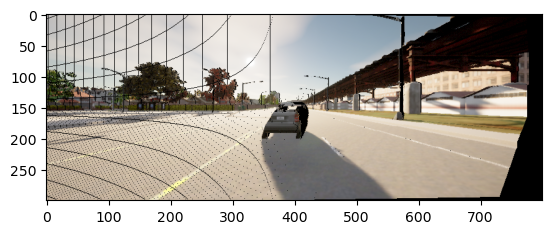

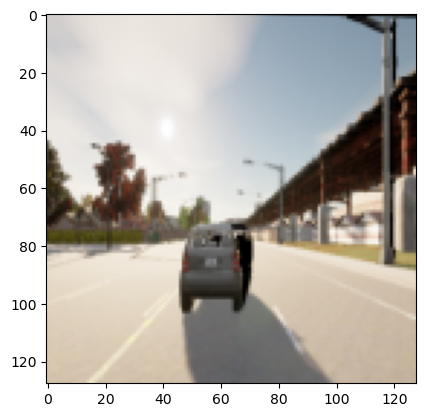

saved to disk
random transfer 0 0.6460413310038486 0.0574868392625498
original delta 7.999975092288789 0.019963034813144986 -2.3461320663938416e-19
delta data 7.950788384661094 -1.0846840888204758 -0.057486839262549806
Point Coud 1, projected back to image 2


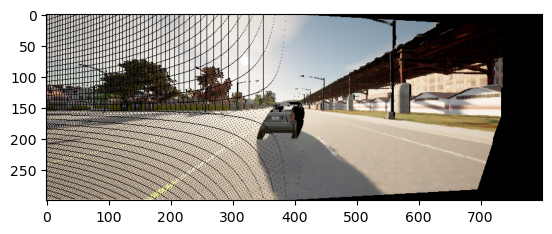

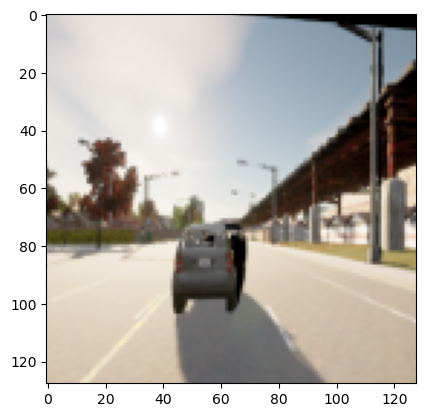

saved to disk
random transfer 0 -1.1475394664652838 -0.025752069590130017
original delta 7.999975092288789 0.019963034813144986 -2.3461320663938416e-19
delta data 7.9672602881161065 1.3731085423740064 0.025752069590130017
Point Coud 1, projected back to image 2


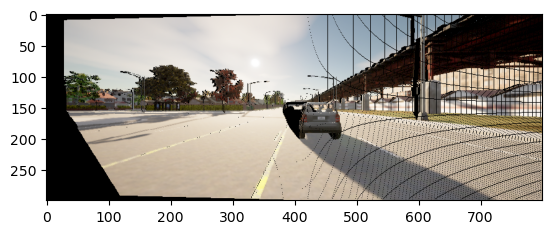

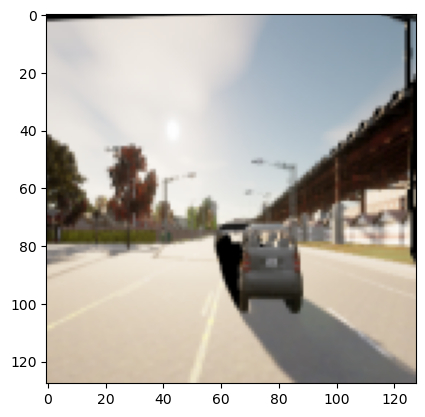

saved to disk
random transfer 0 -0.8042521037357546 -0.17527138386872715
original delta 7.999975092288789 0.019963034813144986 -2.3461320663938416e-19
delta data 7.733686674113477 2.206586163849904 0.17527138386872715
Point Coud 1, projected back to image 2


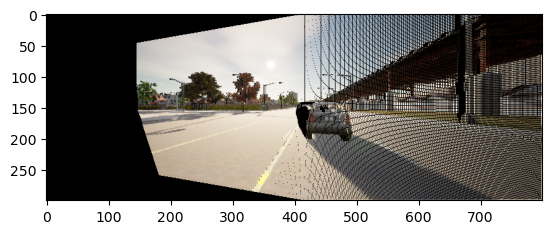

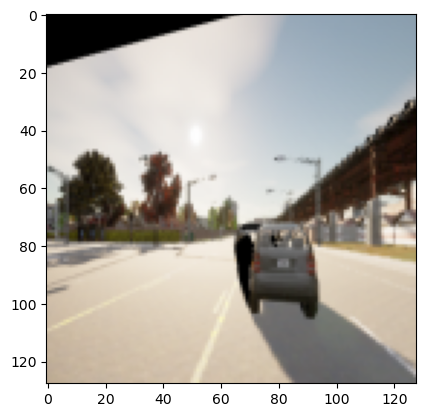

saved to disk
original delta 7.999975092288789 0.019963034813144986 -2.3461320663938416e-19
delta data 7.999975092288789 0.019963034813144986 -2.3461320663938416e-19
Point Coud 1, projected back to image 2


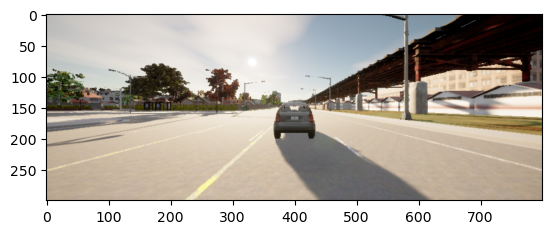

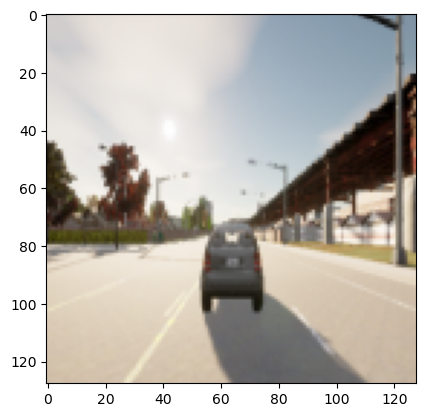

saved to disk
random transfer -1.2859174392924269 0 0
original delta 7.999975092288789 0.019963034813144986 -2.3461320663938416e-19
delta data 9.285892531581215 0.019963034813144986 -2.3461320663938416e-19
Point Coud 1, projected back to image 2


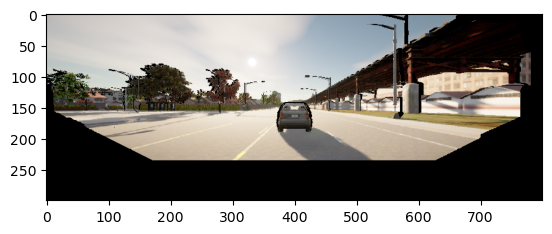

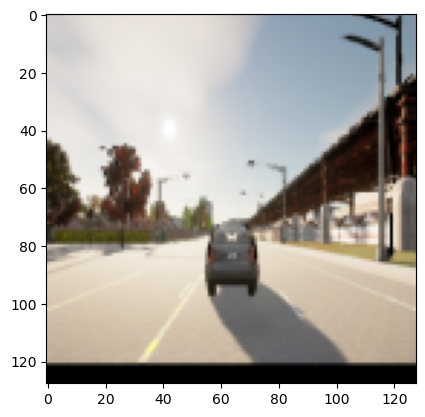

saved to disk
random transfer -2.4261301317476547 0 0
original delta 7.999975092288789 0.019963034813144986 -2.3461320663938416e-19
delta data 10.426105224036444 0.019963034813144986 -2.3461320663938416e-19
Point Coud 1, projected back to image 2


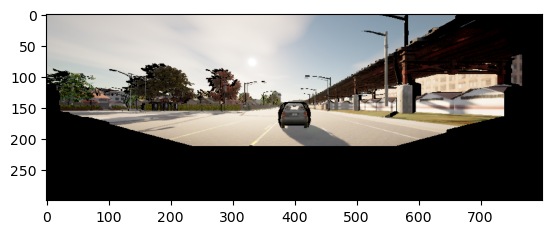

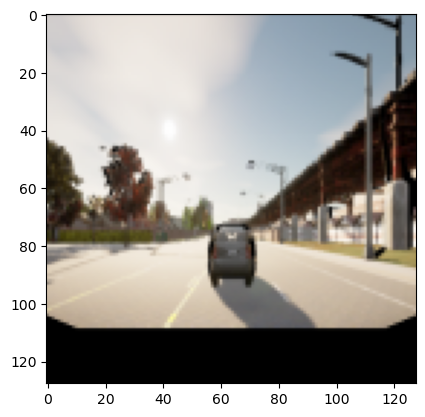

saved to disk
2
random transfer 0 -0.38530384209307605 -0.03340144454515603
original delta 7.999967473549823 0.01995875473451747 -5.326322180166264e-07
delta data 7.981971441275261 0.6721973377727156 0.03340091191293801
Point Coud 1, projected back to image 2


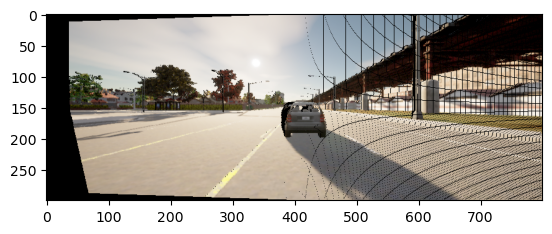

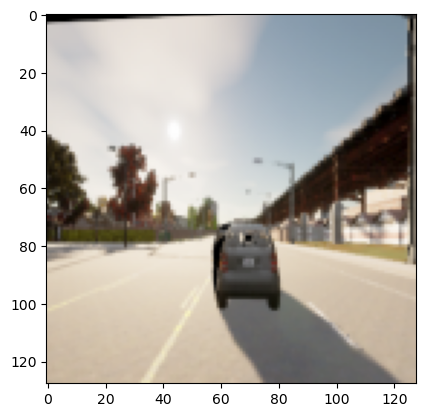

saved to disk
random transfer 0 -0.49209419702816004 -0.06357240582968196
original delta 7.999967473549823 0.01995875473451747 -5.326322180166264e-07
delta data 7.9512766638575485 1.0192532649240724 0.06357187319746394
Point Coud 1, projected back to image 2


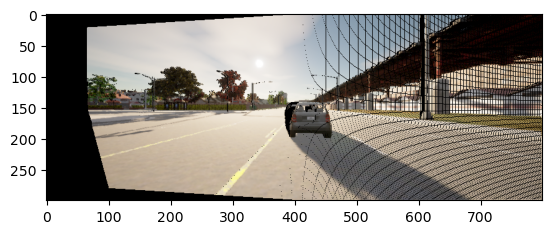

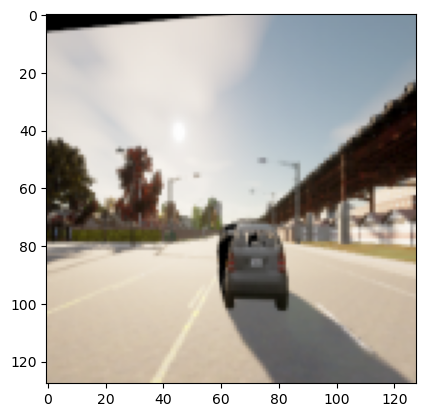

saved to disk
random transfer 0 -1.27741809302273 0.013994968823337117
original delta 7.999967473549823 0.01995875473451747 -5.326322180166264e-07
delta data 8.017340208760517 1.1852941575590188 -0.013995501455555137
Point Coud 1, projected back to image 2


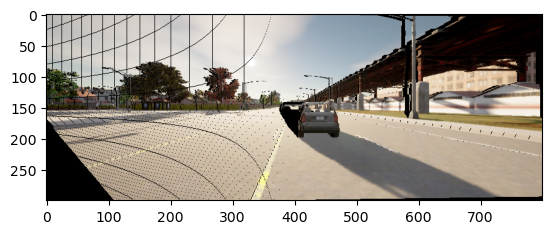

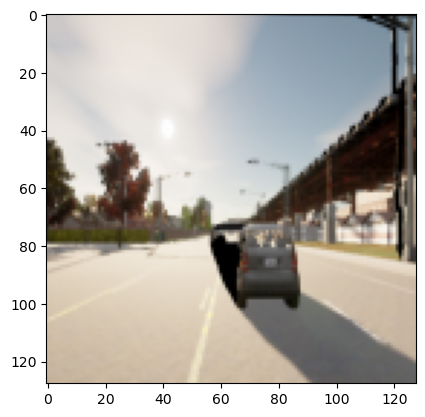

saved to disk
random transfer 0 1.4614853522169708 0.10714918861884293
original delta 7.999967473549823 0.01995875473451747 -5.326322180166264e-07
delta data 7.799924766111271 -2.288810204474915 -0.10714972125106094
Point Coud 1, projected back to image 2


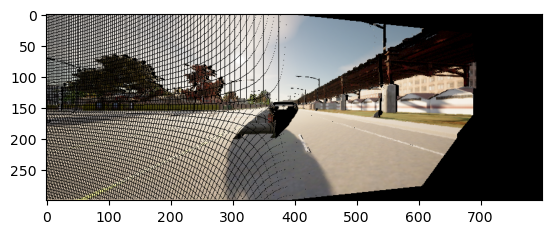

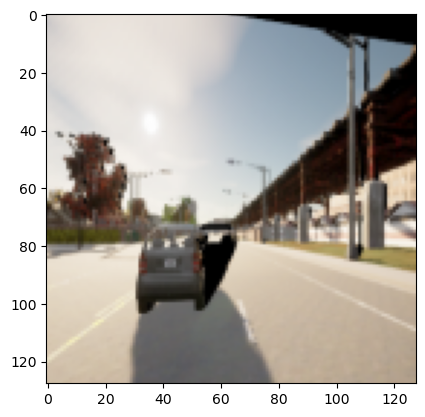

saved to disk
original delta 7.999967473549823 0.01995875473451747 -5.326322180166264e-07
delta data 7.999967473549823 0.01995875473451747 -5.326322180166264e-07
Point Coud 1, projected back to image 2


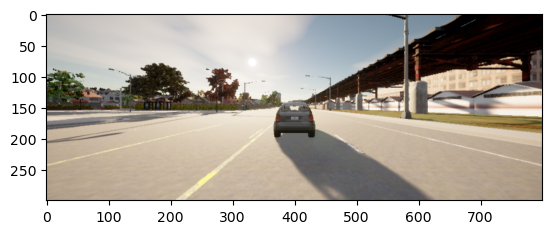

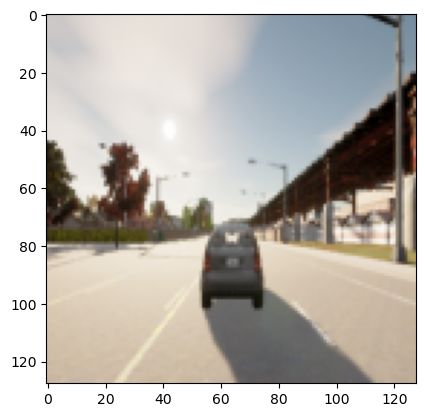

saved to disk
random transfer 1.1636373082658213 0 0
original delta 7.999967473549823 0.01995875473451747 -5.326322180166264e-07
delta data 6.836330165284002 0.01995875473451747 -5.326322180166264e-07
Point Coud 1, projected back to image 2


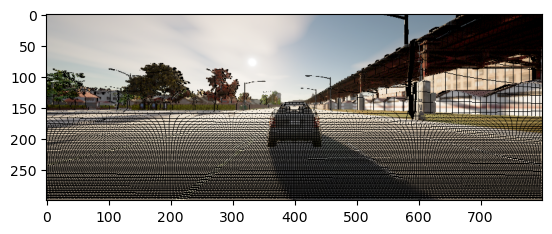

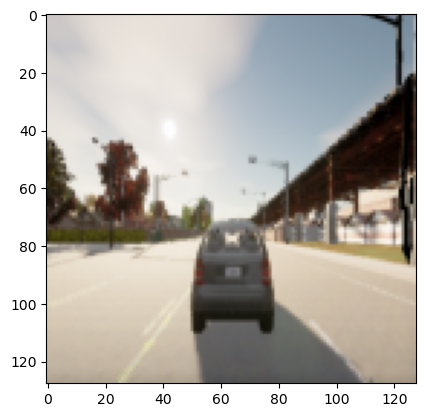

saved to disk
random transfer -0.05459392225557114 0 0
original delta 7.999967473549823 0.01995875473451747 -5.326322180166264e-07
delta data 8.054561395805393 0.01995875473451747 -5.326322180166264e-07
Point Coud 1, projected back to image 2


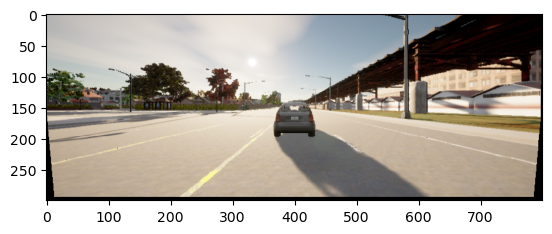

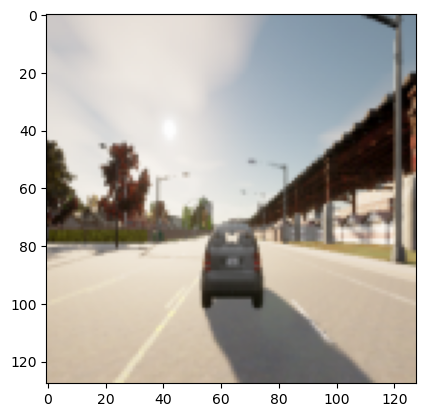

saved to disk
3
random transfer 0 -0.25034183616277506 0.03507335858891866
original delta 7.999963735006293 0.019928225653671916 -5.328922923416568e-07
delta data 8.00452103521259 -0.010424229912861294 -0.035073891481211004
Point Coud 1, projected back to image 2


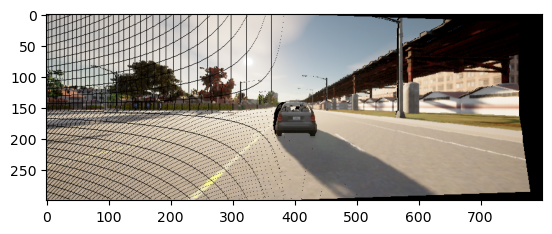

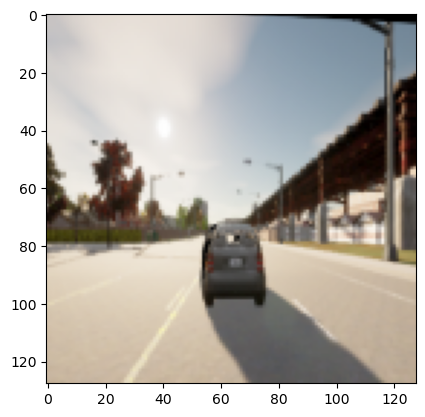

saved to disk
random transfer 0 0.6809118296986052 0.019873389625580634
original delta 7.999963735006293 0.019928225653671916 -5.328922923416568e-07
delta data 7.985248867664933 -0.819829011250506 -0.019873922517872976
Point Coud 1, projected back to image 2


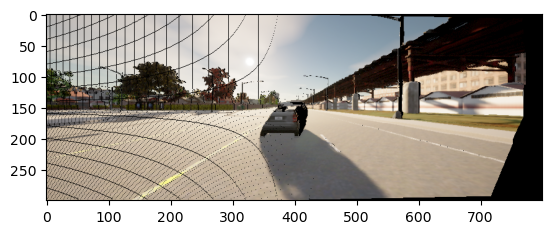

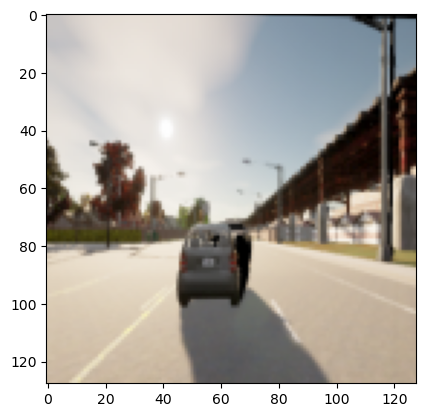

saved to disk
random transfer 0 0.9023685889162243 0.1332253422405456
original delta 7.999963735006293 0.019928225653671916 -5.328922923416568e-07
delta data 7.8118570800259315 -1.9372686229275269 -0.1332258751328379
Point Coud 1, projected back to image 2


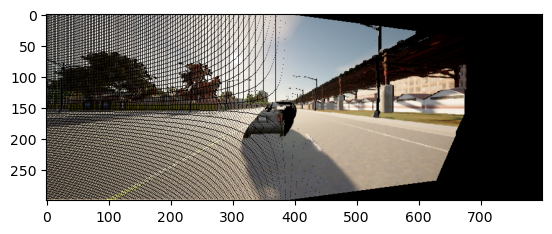

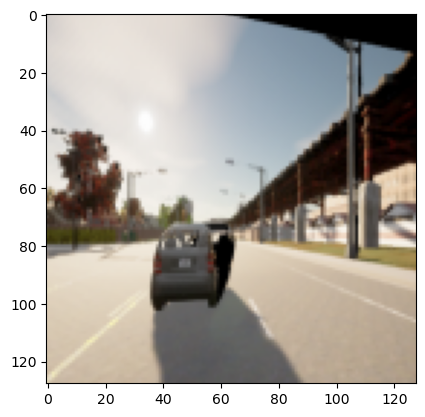

saved to disk
random transfer 0 0.00882611465240668 -0.06127396332275781
original delta 7.999963735006293 0.019928225653671916 -5.328922923416568e-07
delta data 7.98427066216031 0.500964082196206 0.061273430430465466
Point Coud 1, projected back to image 2


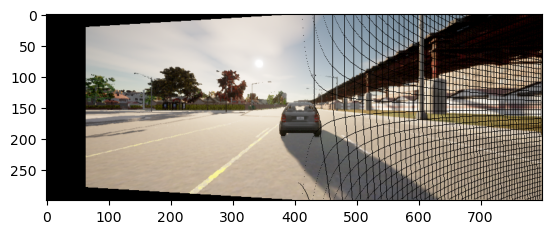

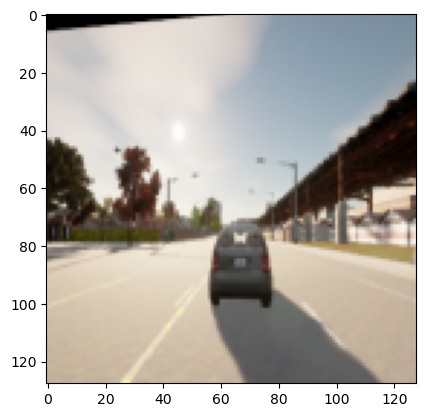

saved to disk
original delta 7.999963735006293 0.019928225653671916 -5.328922923416568e-07
delta data 7.999963735006293 0.019928225653671916 -5.328922923416568e-07
Point Coud 1, projected back to image 2


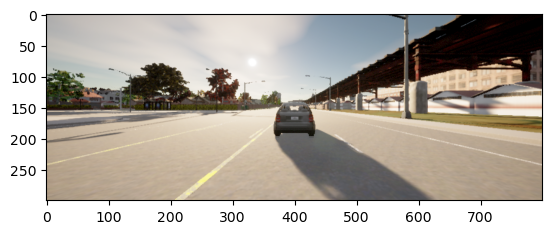

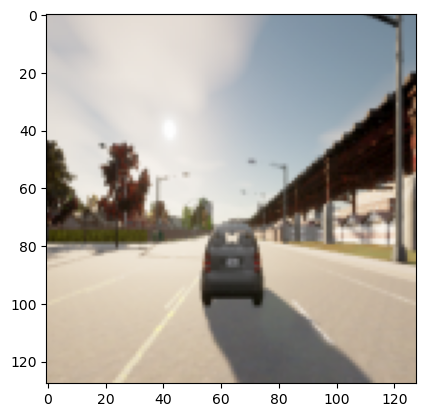

saved to disk
random transfer -0.6625773673222382 0 0
original delta 7.999963735006293 0.019928225653671916 -5.328922923416568e-07
delta data 8.662541102328532 0.019928225653671916 -5.328922923416568e-07
Point Coud 1, projected back to image 2


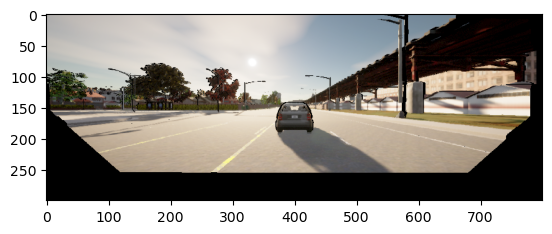

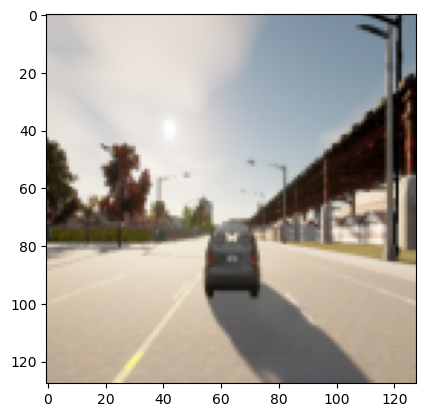

saved to disk
random transfer -0.8520831579188846 0 0
original delta 7.999963735006293 0.019928225653671916 -5.328922923416568e-07
delta data 8.852046892925177 0.019928225653671916 -5.328922923416568e-07
Point Coud 1, projected back to image 2


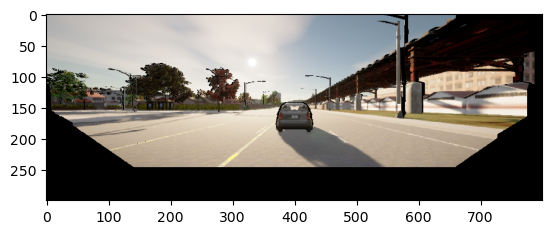

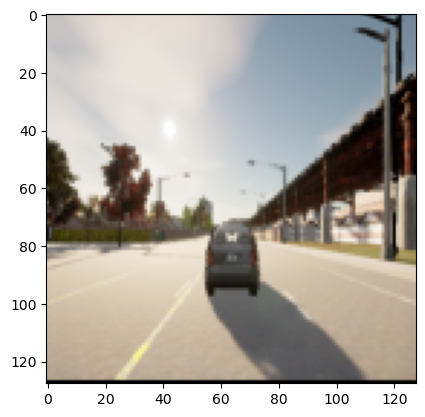

saved to disk
4
random transfer 0 -0.23325292882298232 -0.03401315024761879
original delta 7.999965604285844 0.019943487073220467 -5.328922923410317e-07
delta data 7.9867281454371195 0.5251015384302249 0.03401261735532645
Point Coud 1, projected back to image 2


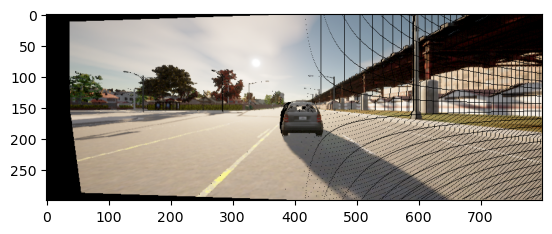

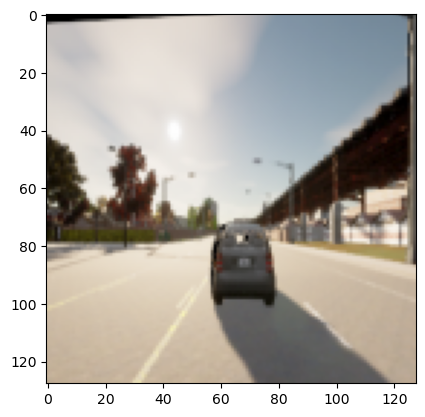

saved to disk
random transfer 0 -0.5254473946702367 0.04715288322623308
original delta 7.999965604285844 0.019943487073220467 -5.328922923410317e-07
delta data 8.016780936507228 0.1677030104076428 -0.047153416118525415
Point Coud 1, projected back to image 2


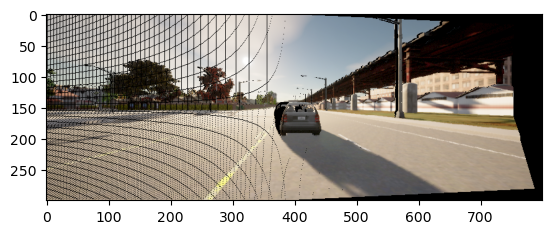

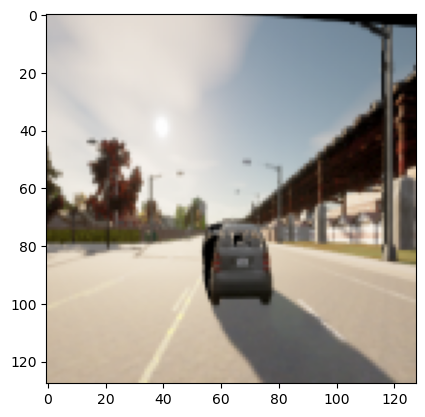

saved to disk
random transfer 0 -0.03643531886964668 -0.09497339088718082
original delta 7.999965604285844 0.019943487073220467 -5.328922923410317e-07
delta data 7.958566650561015 0.8147669041475268 0.09497285799488846
Point Coud 1, projected back to image 2


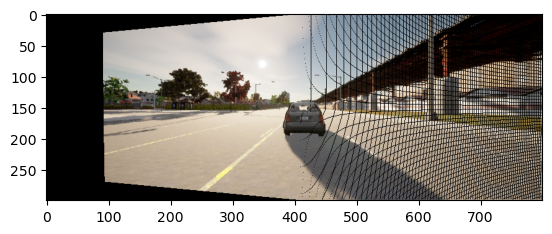

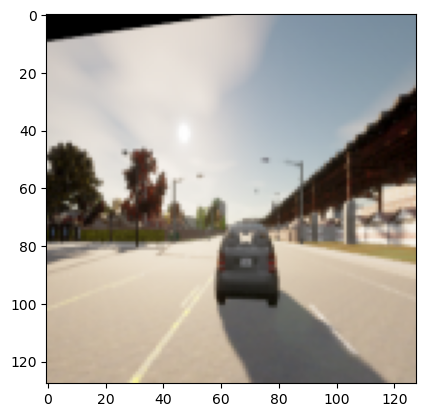

saved to disk
random transfer 0 1.114572346165673 0.013807952753596586
original delta 7.999965604285844 0.019943487073220467 -5.328922923410317e-07
delta data 7.984088878161014 -1.2049841470078404 -0.013808485645888928
Point Coud 1, projected back to image 2


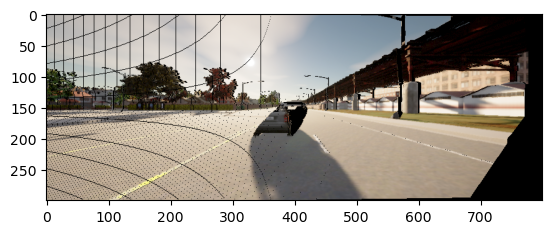

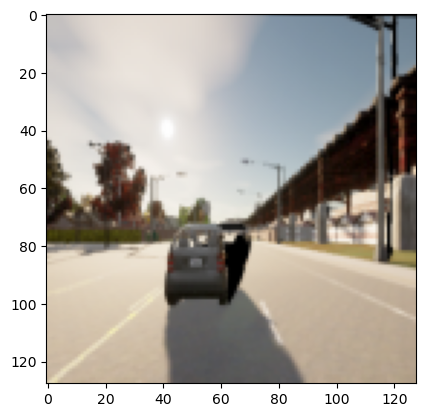

saved to disk
original delta 7.999965604285844 0.019943487073220467 -5.328922923410317e-07
delta data 7.999965604285844 0.019943487073220467 -5.328922923410317e-07
Point Coud 1, projected back to image 2


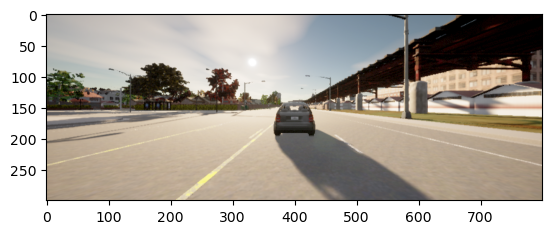

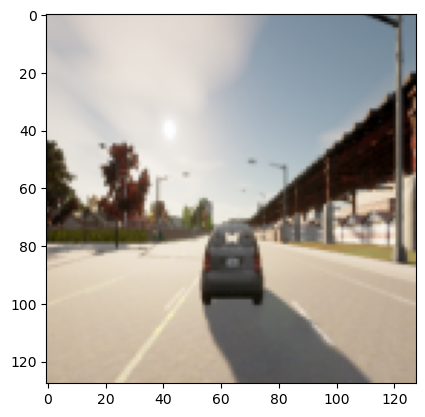

saved to disk
random transfer -1.177749913594507 0 0
original delta 7.999965604285844 0.019943487073220467 -5.328922923410317e-07
delta data 9.177715517880351 0.019943487073220467 -5.328922923410317e-07
Point Coud 1, projected back to image 2


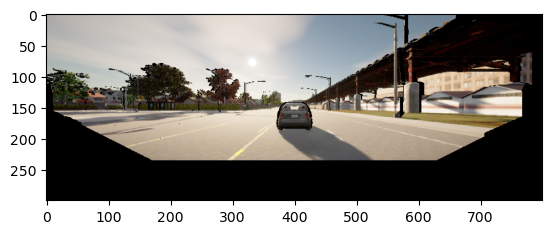

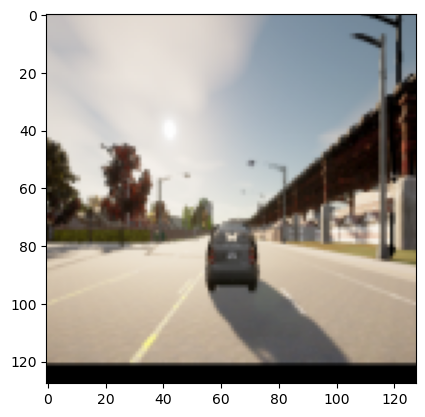

saved to disk
random transfer -2.18311388864708 0 0
original delta 7.999965604285844 0.019943487073220467 -5.328922923410317e-07
delta data 10.183079492932924 0.019943487073220467 -5.328922923410317e-07
Point Coud 1, projected back to image 2


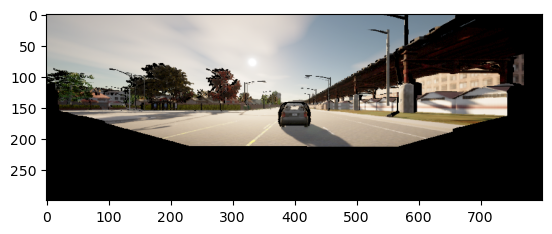

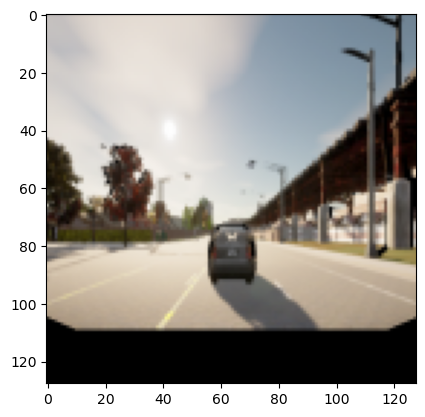

saved to disk


In [2]:
depth_rendering(FOLDER)

Output of this function are rendered off-trajectory and on-trajectory data and the computed relative states, used as ground truth for training. The output images are stored under `data_collection/depth_data/Example_test/images`, and the relative states are stored under `data_collection/depth_data/Example_test/delta_data.txt`. In the Example_test folder, 5 corresponding on-trajectory RGB and depth images are available for image rendering, the total number of output images is 30(off) + 5(on).

### 3.3 Example dataset

The dataset we collected with this method is stored under `dataset/depth_dataset` and we used it for training CNN-MLP model with depth camera.

# 4. Data collection for CNN-MLP model with stereo camera 

This data collection method combines online-mode method and offline-mode method, with online-mode used for collecting on-trajectory data and offline image rendering used for off-trajectory data.

###  4. 1 Online on-trajectory data collection

To collect the on-trajectory with online-mode method, first should run the Carla simulator with:
<br>
`DISPLAY= ./CarlaUE4.sh -opengl`

In [4]:
! python data_collection/stereo_data/carla_online_stereo.py

created target vehicle vehicle.audi.a2
created ego vehicle vehicle.audi.a2
created sensor.camera.rgb
created sensor.camera.rgb
created sensor.camera.rgb
Create vehicle_follow and vehicle_lead in the figure.
frame 0
TARGET Vehicle
Location: (x,y,z): (223.1039276123047,-395.6427001953125,0.22806409001350403)
Throttle: 0.0, Steering Angle: 0.0, Brake: 0.0
EGO Vehicle
Location: (x,y,z): (231.1039276123047,-395.6427001953125,0.22806409001350403)
Throttle: 0.0, Steering Angle: 0.0, Brake: 0.0
frame 1
TARGET Vehicle
Location: (x,y,z): (223.1039276123047,-395.6427001953125,0.07629331201314926)
Throttle: 0.699999988079071, Steering Angle: 0.0, Brake: 0.0
EGO Vehicle
Location: (x,y,z): (231.1039276123047,-395.6427001953125,0.07629331201314926)
Throttle: 1.0, Steering Angle: -1.6980564396362752e-05, Brake: 0.0
frame 2
TARGET Vehicle
Location: (x,y,z): (223.10372924804688,-395.64263916015625,-0.03778749331831932)
Throttle: 0.699999988079071, Steering Angle: 0.0, Brake: 0.0
EGO Vehicle
Location: (x

TARGET Vehicle
Location: (x,y,z): (223.10372924804688,-395.6426086425781,-0.007698421366512775)
Throttle: 0.699999988079071, Steering Angle: 2.5326428954031144e-07, Brake: 0.0
EGO Vehicle
Location: (x,y,z): (231.10374450683594,-395.64263916015625,-0.007650165352970362)
Throttle: 1.0, Steering Angle: 0.0023558642715215683, Brake: 0.0
frame 14
TARGET Vehicle
Location: (x,y,z): (223.10372924804688,-395.6426086425781,-0.007719287648797035)
Throttle: 0.699999988079071, Steering Angle: 2.5326428954031144e-07, Brake: 0.0
EGO Vehicle
Location: (x,y,z): (231.10374450683594,-395.64263916015625,-0.0076995654962956905)
Throttle: 1.0, Steering Angle: 0.0004898359766229987, Brake: 0.0
frame 15
TARGET Vehicle
Location: (x,y,z): (223.10372924804688,-395.6426086425781,-0.007721881847828627)
Throttle: 0.699999988079071, Steering Angle: 2.5326428954031144e-07, Brake: 0.0
EGO Vehicle
Location: (x,y,z): (231.10374450683594,-395.64263916015625,-0.007705554831773043)
Throttle: 1.0, Steering Angle: -6.6608263

The outputs of this script include RGB images from the two RGB cameras, and raw states, which are all stored in the folder `data_collection/stereo_data/output` automatically.
<br>
This example script is shown with spawn point 5 in town4, this can be changed at line 155 and 169.
<br>
To collect for different trajectories, the parameter FLAG at line 35 should be modified each time.

### 4.2 Offline image rendering for off-trajectory data

Off-trajectory data are generated with image rendering method offline. Pre-collected images and data are used as example, these are stored in `data_collection/stereo_data/Example_test`. Helper function is written in the script `data_collection/stereo_data/stereo_offline.py`.
<br>
*The notebook is written based on tutorial of assignment 4.*

In [3]:
import sys
from data_collection.stereo_data.stereo_offline import stereo_rendering
FOLDER = sys.path[0]+'/data_collection/stereo_data/Example_test/'

num 0
FLAG 0
0


/media/melina/Extreme SSD/Carla_0.9.11/PythonAPI/examples/data_collection/stereo_data/stereo_offline.py:314: RuntimeWarning: divide by zero encountered in true_divide
  depth = (0.5*10)/(disparity)


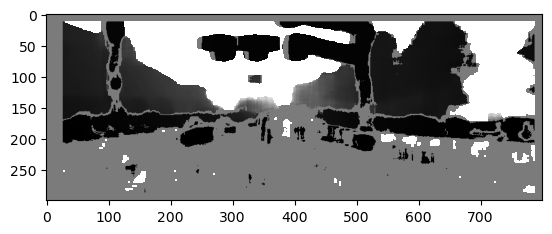

random transfer 0 -0.4346270968900665 -0.0035531495300351185
original delta 7.999834624254959 0.051439134634784 1.2511068330405683e-20
delta data 7.998057063497566 0.514487712092264 0.0035531495300351185
0.625
Point Coud 1, projected back to image 2


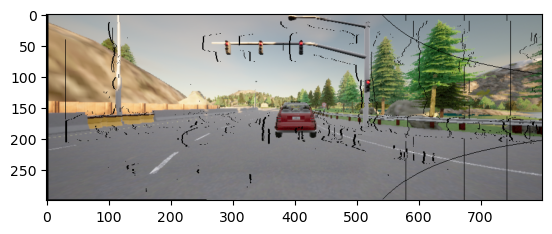

Resized image


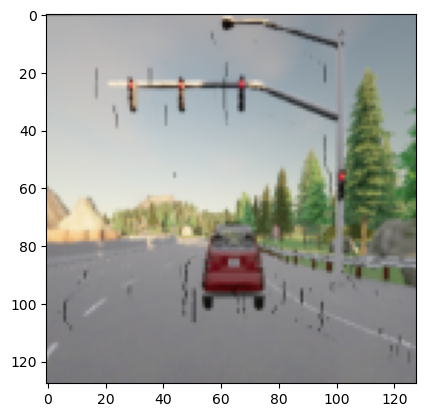

saved to disk
random transfer 0 0.7204693537948006 -0.0556455684011463
original delta 7.999834624254959 0.051439134634784 1.2511068330405683e-20
delta data 8.024661715916482 -0.2230690356865218 0.0556455684011463
0.625
Point Coud 1, projected back to image 2


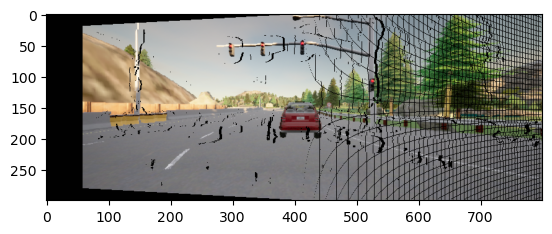

Resized image


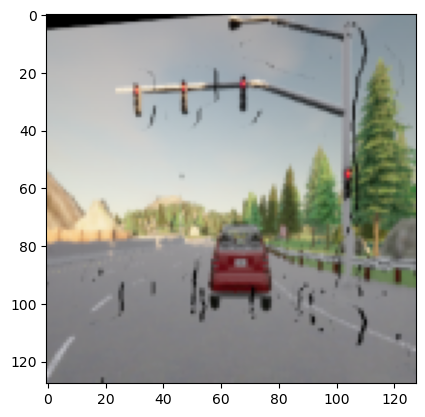

saved to disk
random transfer 0 1.1742576082627494 0.026453092888048813
original delta 7.999834624254959 0.051439134634784 1.2511068330405683e-20
delta data 7.967337223418346 -1.3340213298449046 -0.026453092888048813
0.625
Point Coud 1, projected back to image 2


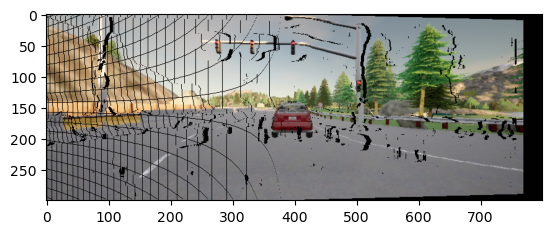

Resized image


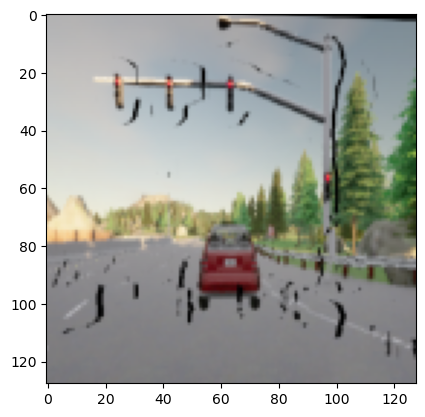

saved to disk
random transfer 0 -1.33616064013987 0.0016578510182216066
original delta 7.999834624254959 0.051439134634784 1.2511068330405683e-20
delta data 8.002124063250463 1.3743353399847684 -0.0016578510182216068
0.625
Point Coud 1, projected back to image 2


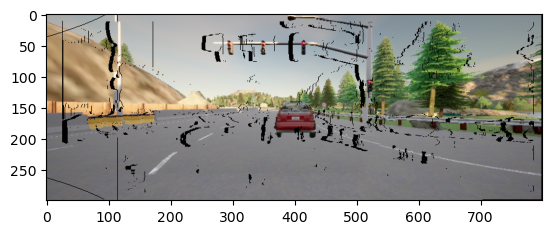

Resized image


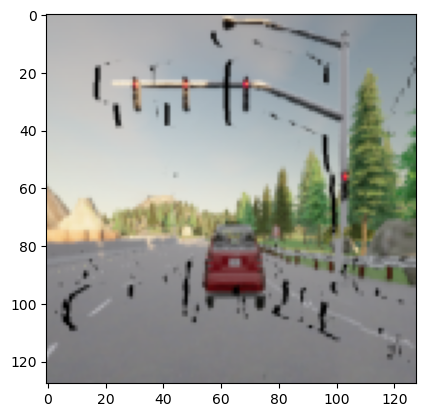

saved to disk
original delta 7.999834624254959 0.051439134634784 1.2511068330405683e-20
delta data 7.999834624254959 0.051439134634784 1.2511068330405683e-20
0.625
Point Coud 1, projected back to image 2


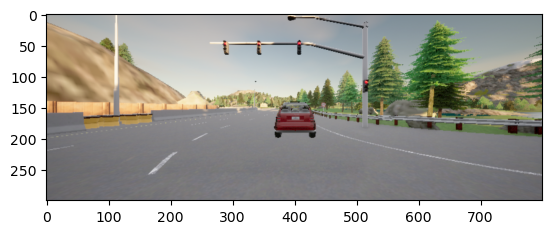

Resized image


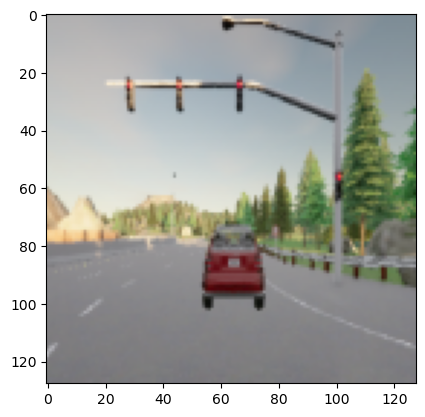

saved to disk
random transfer -2.8317006487918626 0 0
original delta 7.999834624254959 0.051439134634784 1.2511068330405683e-20
delta data 10.831535273046821 0.051439134634784 1.2511068330405683e-20
0.625
Point Coud 1, projected back to image 2


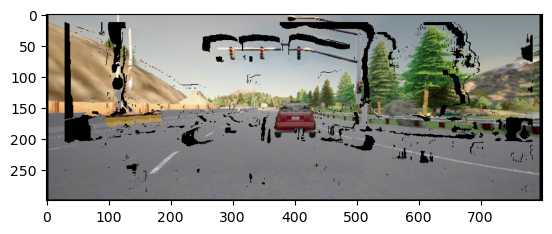

Resized image


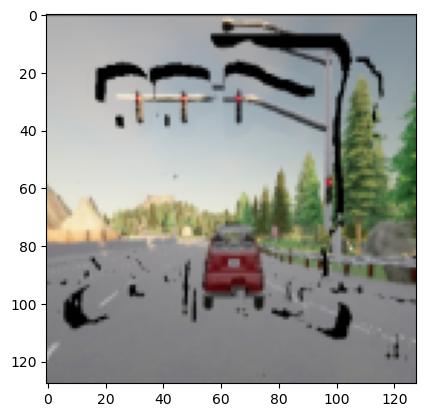

saved to disk
1


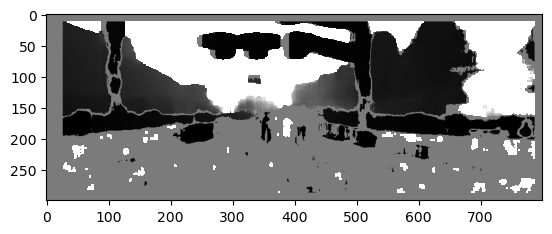

random transfer 0 0.1838270747542856 0.016691506685306085
original delta 7.999834624254959 0.051439134634784 1.2511068330405683e-20
delta data 7.996510596003313 -0.2658925913302342 -0.016691506685306085
0.625
Point Coud 1, projected back to image 2


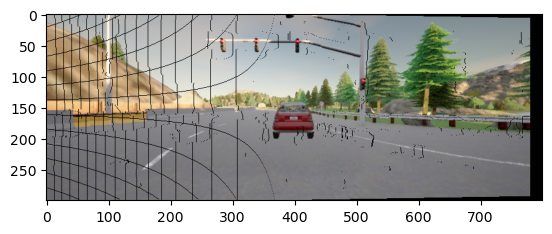

Resized image


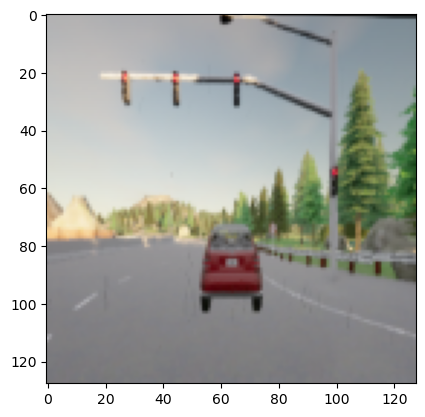

saved to disk
random transfer 0 0.19417176355107346 -0.022765752351242008
original delta 7.999834624254959 0.051439134634784 1.2511068330405683e-20
delta data 8.001010773729767 0.0394108797924298 0.022765752351242004
0.625
Point Coud 1, projected back to image 2


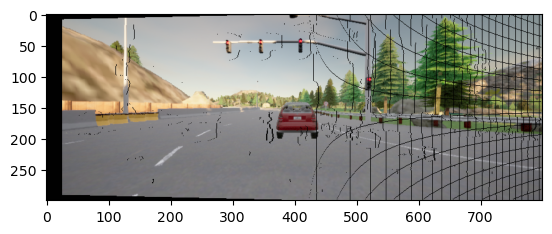

Resized image


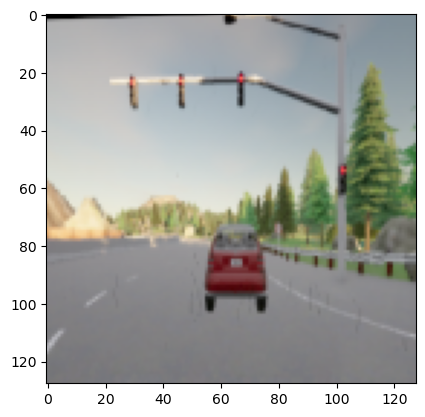

saved to disk
random transfer 0 0.5721979570203741 -0.13899524246180886
original delta 7.999834624254959 0.051439134634784 1.2511068330405683e-20
delta data 7.994832000484295 0.5926255567836959 0.13899524246180883
0.625
Point Coud 1, projected back to image 2


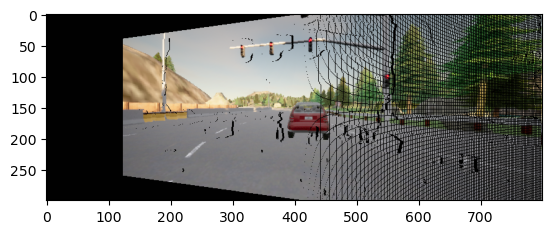

Resized image


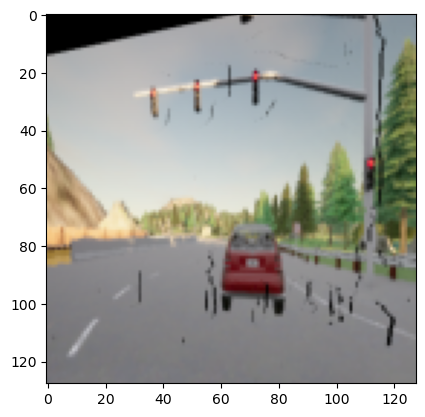

saved to disk
random transfer 0 1.701351736301922 0.05577235907391512
original delta 7.999834624254959 0.051439134634784 1.2511068330405683e-20
delta data 7.8954240619303 -2.093285573174512 -0.05577235907391513
0.625
Point Coud 1, projected back to image 2


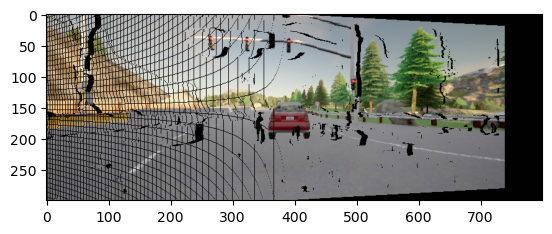

Resized image


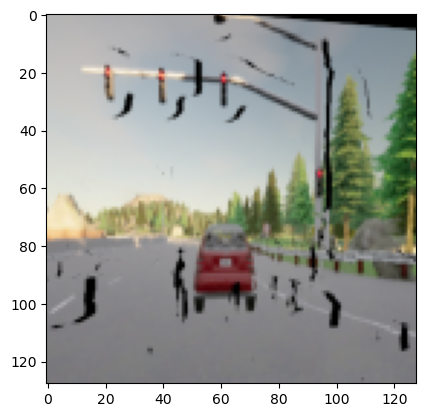

saved to disk
original delta 7.999834624254959 0.051439134634784 1.2511068330405683e-20
delta data 7.999834624254959 0.051439134634784 1.2511068330405683e-20
0.625
Point Coud 1, projected back to image 2


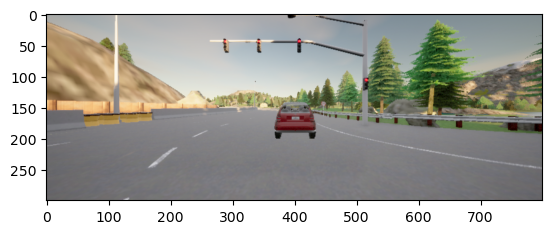

Resized image


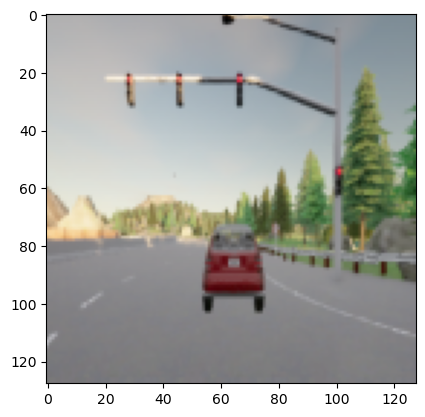

saved to disk
random transfer 0.8356902230653245 0 0
original delta 7.999834624254959 0.051439134634784 1.2511068330405683e-20
delta data 7.164144401189635 0.051439134634784 1.2511068330405683e-20
0.625
Point Coud 1, projected back to image 2


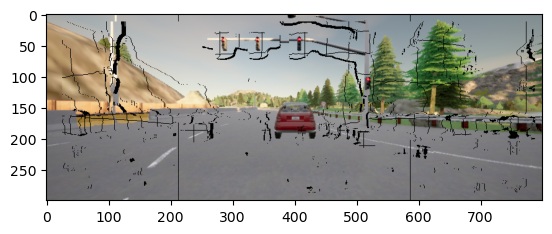

Resized image


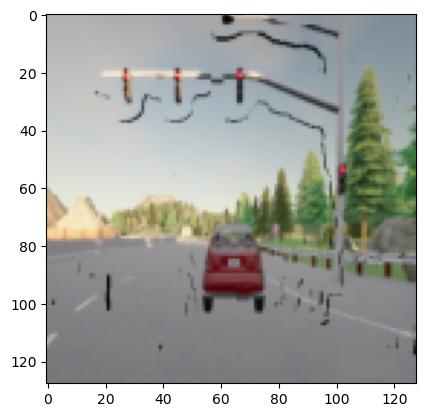

saved to disk
2


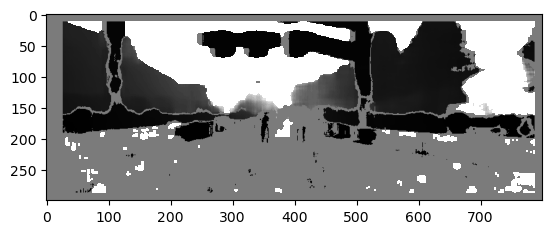

random transfer 0 0.3478180694179971 0.00235647087228448
original delta 7.999927134484267 0.05129050679051739 2.3968449807119314e-06
delta data 7.999206164959502 -0.31537831715156445 -0.0023540740273037685
0.625
Point Coud 1, projected back to image 2


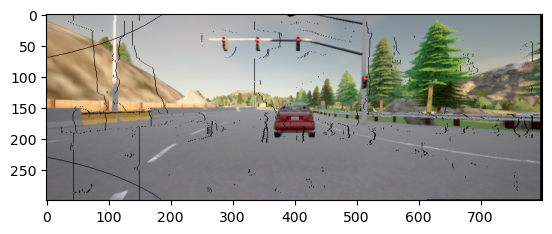

Resized image


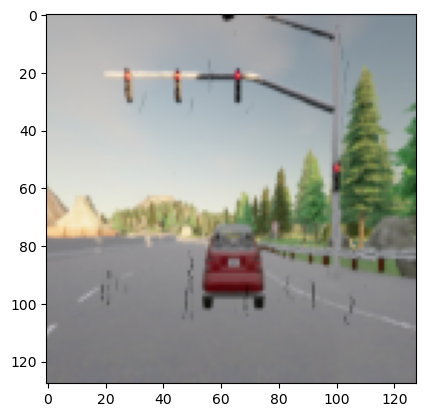

saved to disk
random transfer 0 0.5529201062263345 0.03184717508741387
original delta 7.999927134484267 0.05129050679051739 2.3968449807119314e-06
delta data 7.979897758756715 -0.7561072489252822 -0.03184477824243316
0.625
Point Coud 1, projected back to image 2


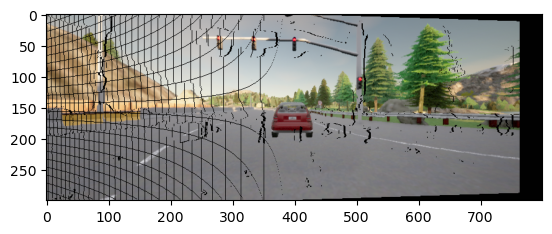

Resized image


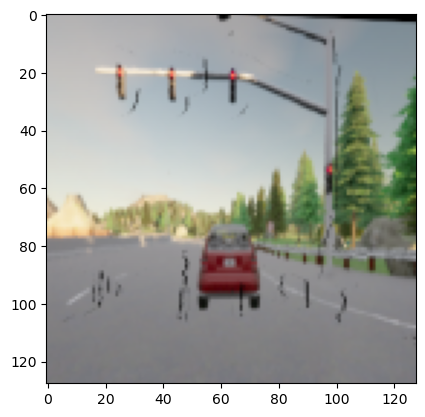

saved to disk
random transfer 0 1.7753129542697468 -0.14103610102790903
original delta 7.999927134484267 0.05129050679051739 2.3968449807119314e-06
delta data 8.162839046991275 -0.5823626442213501 0.14103849787288972
0.625
Point Coud 1, projected back to image 2


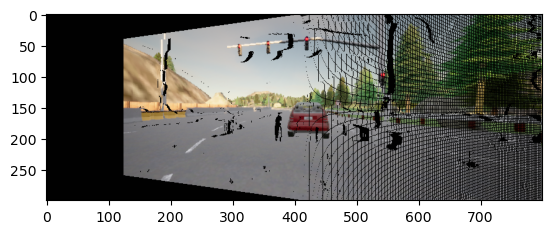

Resized image


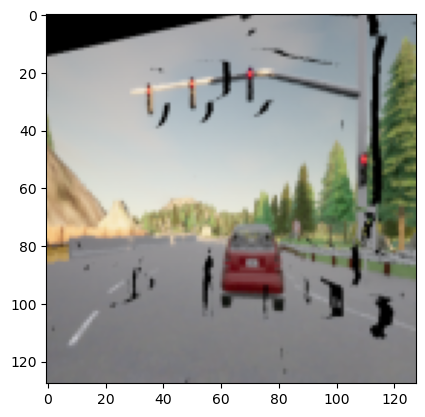

saved to disk
random transfer 0 0.007242928943924198 -0.12324681393365525
original delta 7.999927134484267 0.05129050679051739 2.3968449807119314e-06
delta data 7.933830458907778 1.0271847913004815 0.12324921077863595
0.625
Point Coud 1, projected back to image 2


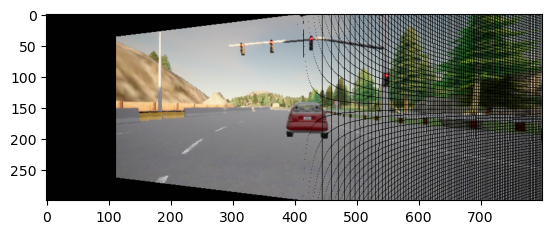

Resized image


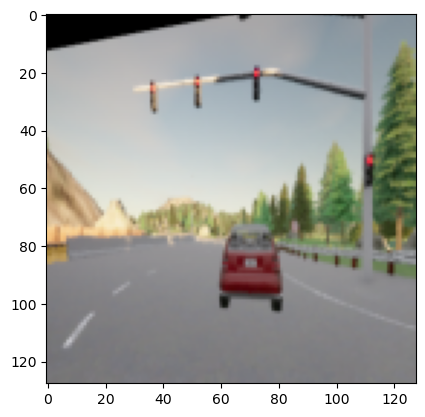

saved to disk
original delta 7.999927134484267 0.05129050679051739 2.3968449807119314e-06
delta data 7.999927134484267 0.05129050679051739 2.3968449807119314e-06
0.625
Point Coud 1, projected back to image 2


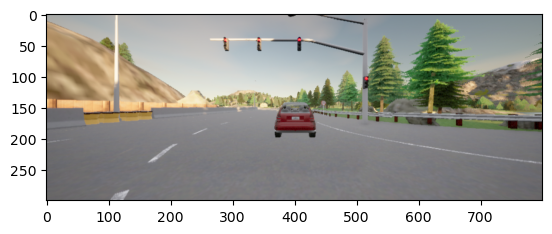

Resized image


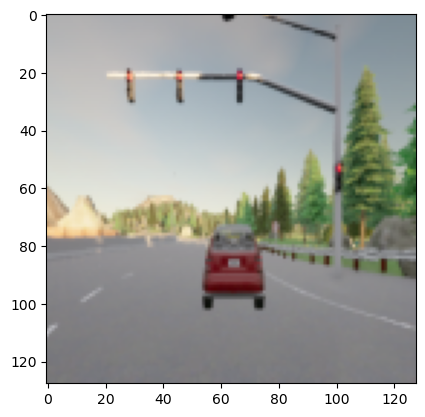

saved to disk
random transfer -0.5608972779422641 0 0
original delta 7.999927134484267 0.05129050679051739 2.3968449807119314e-06
delta data 8.56082441242653 0.05129050679051739 2.3968449807119314e-06
0.625
Point Coud 1, projected back to image 2


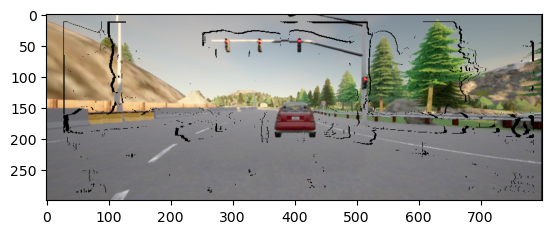

Resized image


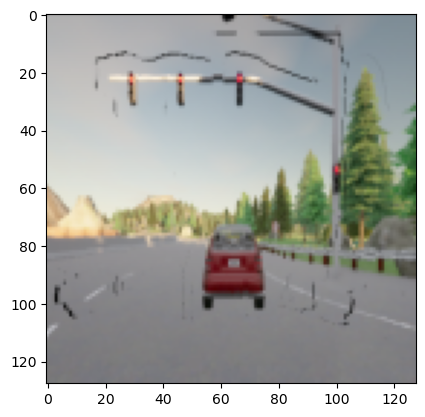

saved to disk
3


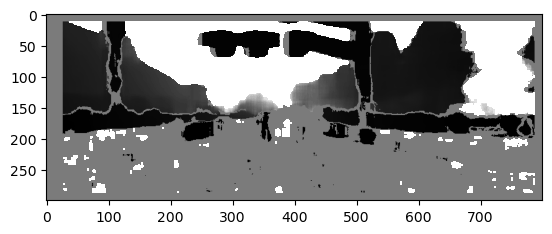

random transfer 0 -0.625054934342821 0.06313874039173778
original delta 7.999866122049866 0.051286776582455396 2.3968449807119314e-06
delta data 8.02660067987879 0.17022810116966836 -0.06313634354675707
0.625
Point Coud 1, projected back to image 2


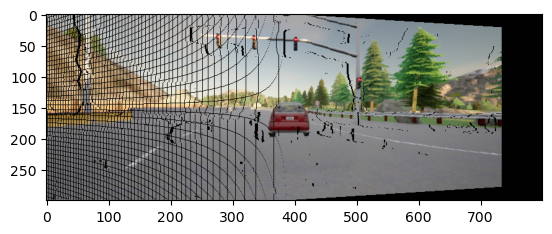

Resized image


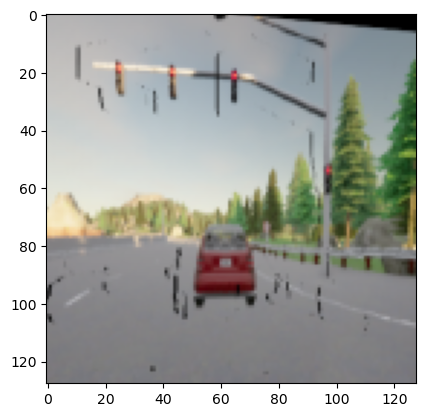

saved to disk
random transfer 0 0.5871038337963639 -0.007067039021281307
original delta 7.999866122049866 0.051286776582455396 2.3968449807119314e-06
delta data 8.003452962594602 -0.4792687816437118 0.0070694358662620185
0.625
Point Coud 1, projected back to image 2


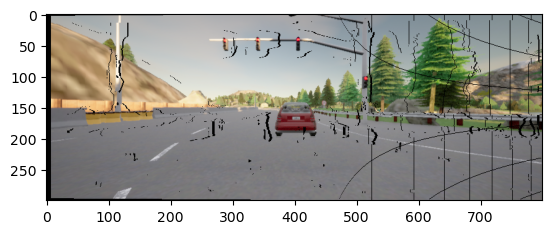

Resized image


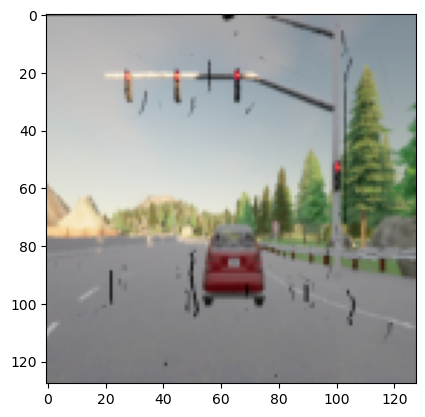

saved to disk
random transfer 0 1.401296843751462 0.017410772635465754
original delta 7.999866122049866 0.051286776582455396 2.3968449807119314e-06
delta data 7.97515010211989 -1.4890822679878806 -0.017408375790485042
0.625
Point Coud 1, projected back to image 2


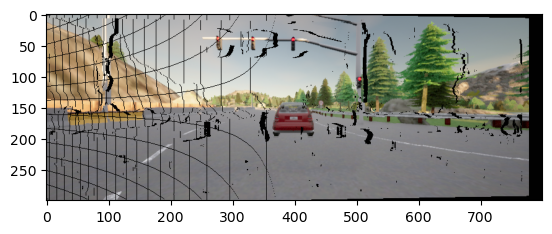

Resized image


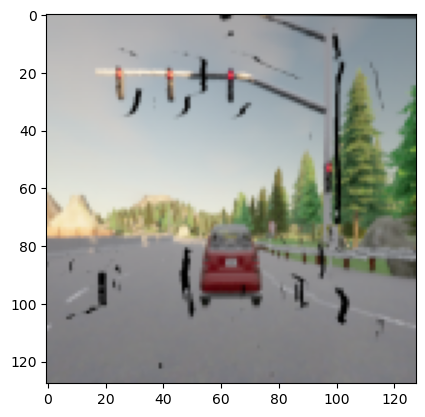

saved to disk
random transfer 0 -1.9201746490566682 -0.01818973100139204
original delta 7.999866122049866 0.051286776582455396 2.3968449807119314e-06
delta data 7.962684339884357 2.116642678126051 0.018192127846372752
0.625
Point Coud 1, projected back to image 2


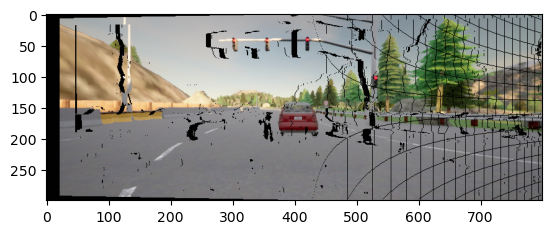

Resized image


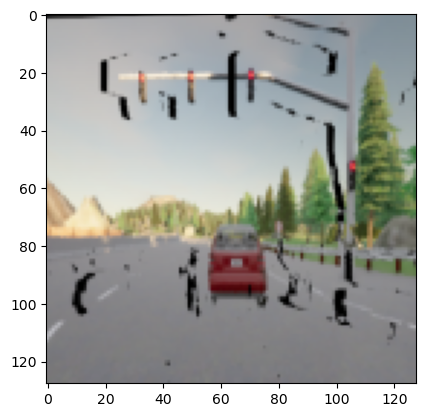

saved to disk
original delta 7.999866122049866 0.051286776582455396 2.3968449807119314e-06
delta data 7.999866122049866 0.051286776582455396 2.3968449807119314e-06
0.625
Point Coud 1, projected back to image 2


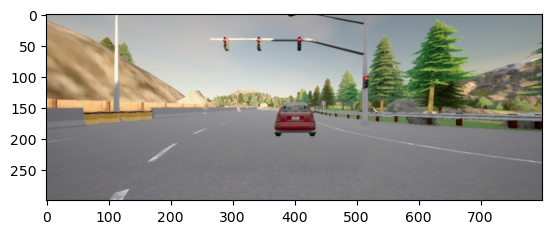

Resized image


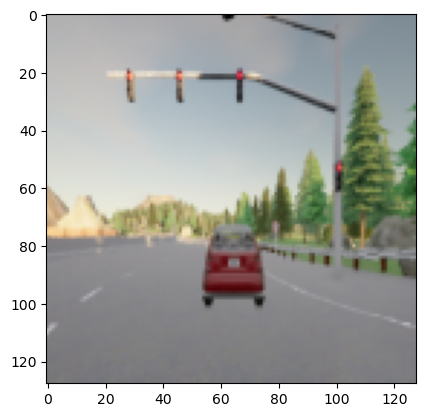

saved to disk
random transfer -2.9971885776048683 0 0
original delta 7.999866122049866 0.051286776582455396 2.3968449807119314e-06
delta data 10.997054699654734 0.051286776582455396 2.3968449807119314e-06
0.625
Point Coud 1, projected back to image 2


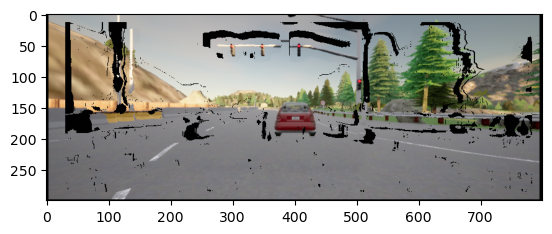

Resized image


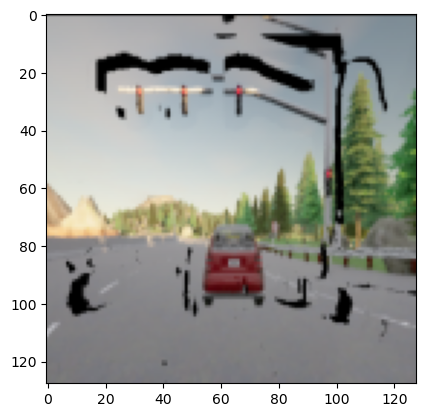

saved to disk
4


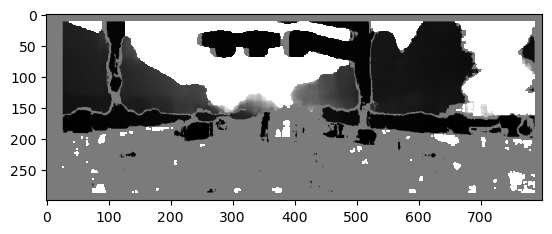

random transfer 0 0.2106067048343332 0.010729728447207196
original delta 7.999866122049866 0.051286776582455396 2.3968449807119314e-06
delta data 7.997696199118426 -0.24514550141907815 -0.010727331602226482
0.625
Point Coud 1, projected back to image 2


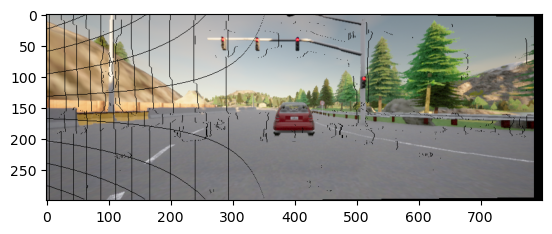

Resized image


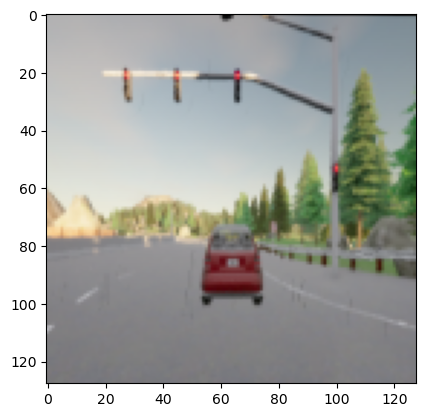

saved to disk
random transfer 0 0.2227448865095656 -0.017904045105297424
original delta 7.999866122049866 0.051286776582455396 2.3968449807119314e-06
delta data 8.00165358816404 -0.02820831796643894 0.017906441950278133
0.625
Point Coud 1, projected back to image 2


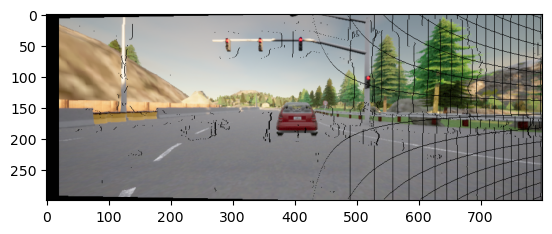

Resized image


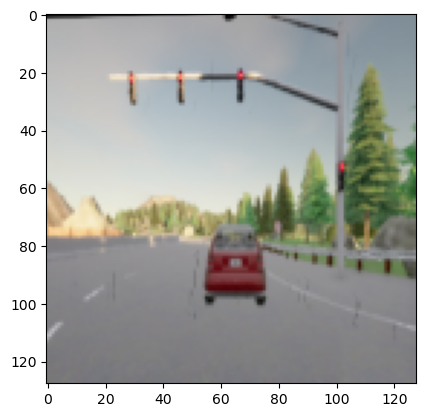

saved to disk
random transfer 0 0.950889902115299 -0.11084055654054696
original delta 7.999866122049866 0.051286776582455396 2.3968449807119314e-06
delta data 8.05028318398854 -0.00918758841970213 0.11084295338552767
0.625
Point Coud 1, projected back to image 2


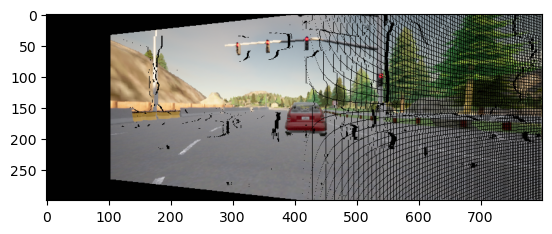

Resized image


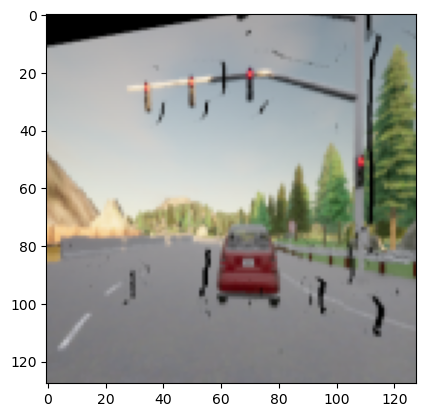

saved to disk
random transfer 0 1.1788264654936214 0.14178758492646265
original delta 7.999866122049866 0.051286776582455396 2.3968449807119314e-06
delta data 7.76025121795414 -2.246709762081509 -0.14178518808148194
0.625
Point Coud 1, projected back to image 2


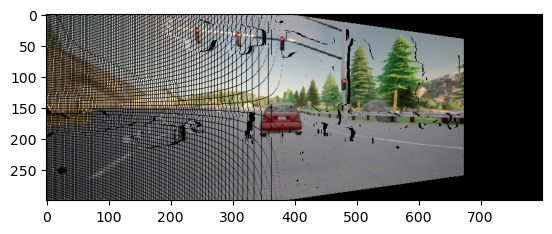

Resized image


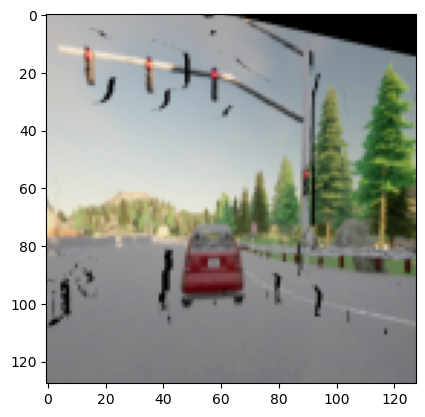

saved to disk
original delta 7.999866122049866 0.051286776582455396 2.3968449807119314e-06
delta data 7.999866122049866 0.051286776582455396 2.3968449807119314e-06
0.625
Point Coud 1, projected back to image 2


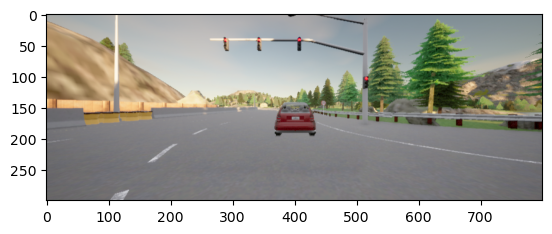

Resized image


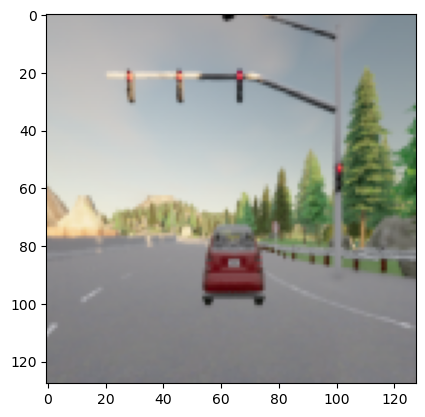

saved to disk
random transfer -2.6742742379896147 0 0
original delta 7.999866122049866 0.051286776582455396 2.3968449807119314e-06
delta data 10.67414036003948 0.051286776582455396 2.3968449807119314e-06
0.625
Point Coud 1, projected back to image 2


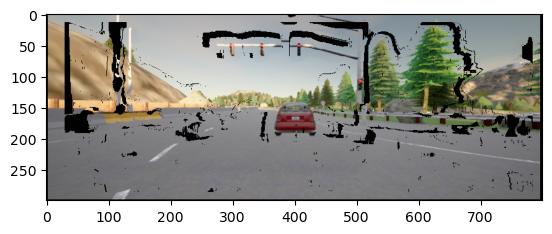

Resized image


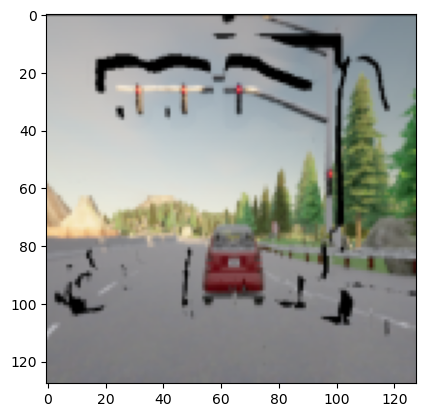

saved to disk


In [4]:
stereo_rendering(FOLDER)

Output of this function are rendered off-trajectory and on-trajectory data and the computed relative states, used as ground truth for training. The output images are stored under `data_collection/stereo_data/Example_test/images`, and the relative states are stored under `data_collection/stereo_data/Example_test/delta_data.txt`. In the Example_test folder, 5 sets of on-trajectory corresponding RGB images are available for image rendering, the total number of output images is 25(off) + 5(on).

### 4.3 Example dataset

The dataset we collected with this method is stored under `dataset/stereo_dataset` and we used it for training CNN-MLP model with stereo camera.

# Summary

In this notebook, different data collection methods are introduced, the dataset we collected with these methods can be found under `/storage/remote/atcremers51/truck_platooning/dataset`.